In [261]:
import matplotlib.pyplot as plt
import strauss
from strauss.sonification import Sonification
from strauss import channels
from strauss.generator import Sampler
from strauss.score import Score
from strauss.generator import Synthesizer
import IPython.display as ipd
from strauss.sources import Events
import os
from scipy.interpolate import interp1d
import numpy as np
import copy
import wavio as wav

import sys
sys.path.append('../')
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import time
from mike_code import LaguerreAmplitudes
from functionalities import *
import matplotlib.cm as cm
from skimage.transform import resize_local_mean
from combine_sonifications import combine_save_sonifications

from mido import Message, MidiFile, MidiTrack
import mido

import time

from FLEX_ed import ExpandGalaxies, BeefIt


import ffmpeg
import glob

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


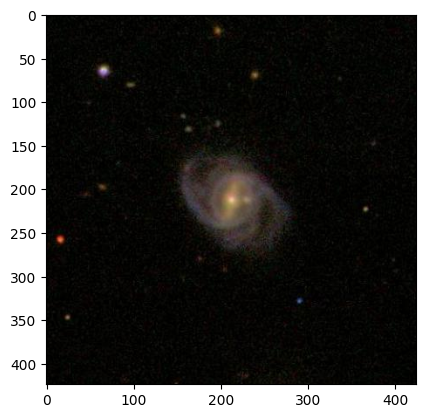

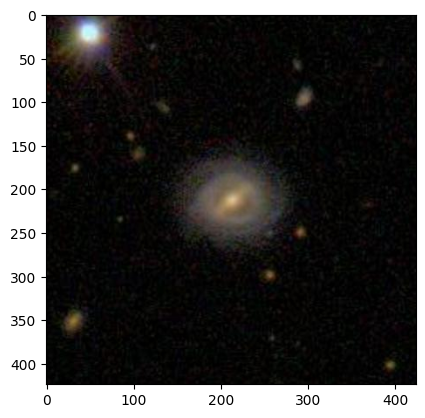

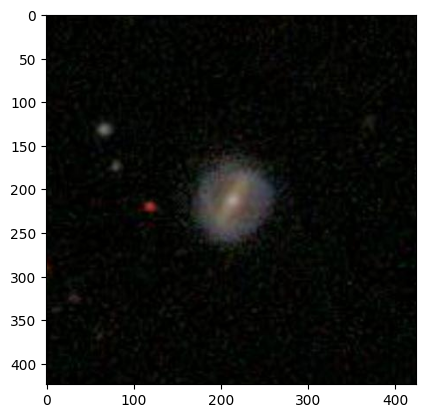

In [269]:
elliptical = ['GZ2_images/844.jpg','GZ2_images/290897.jpg','GZ2_images/287823.jpg'] 
spiral = ['GZ2_images/290248.jpg','GZ2_images/291065.jpg','GZ2_images/295140.jpg'] #293157 is meh on nearby, as is 293764
edge_on = ['GZ2_images/99129.jpg','GZ2_images/293446.jpg','GZ2_images/294943.jpg']
barred = ['GZ2_images/290722.jpg','GZ2_images/288813.jpg','GZ2_images/294348.jpg'] #288325 has bearby
interacting = ['GZ2_images/290026.jpg','GZ2_images/289500.jpg','GZ2_images/288109.jpg']
artefact = ['GZ2_images/258142.jpg', 'GZ2_images/169394.jpg','GZ2_images/261434.jpg']


for image in barred:
    im = Image.open('../'+image)
    a = np.asarray(im)
    plt.figure()
    plt.imshow(a)

In [273]:
#np.degrees(np.linspace(-np.pi, np.pi, 720)[1]-np.linspace(-np.pi, np.pi, 720)[0])

# third mapping in the survey - m = 7, n = 12, m to instruments and n to notes - length = 3 seconds

In [263]:
test1 = Sampler("../op1 synth 8.sf2", sf_preset=0)
test1_generator = copy.copy(test1)

In [264]:
def mod_map_to_sounds_octave_ampcutoff(cos_cos, sin_cos):
    note_list = np.array(['D#','A#','F','C','G', 'D', 'A', 'E','B','F#','C#','G#'])
    mmax = cos_cos.shape[0]
    nmax = cos_cos.shape[1]

    modulus = np.sqrt(cos_cos**2 + sin_cos**2)
    
    abs_max = np.max(modulus)
    note_dict = {}
    
    for m in range(mmax):
        octave = m + 1 #hmm. running into issues that there are only some notes at m = 0 and m = 8... 
        #can kinda avoid bc last few terms are usually low amplitude but not really a fix here...
        for n in range(nmax):
            amp = modulus[m,n]/modulus[0,0]
            if abs(amp) >= 0.01*(abs_max/modulus[0,0]): #will only play terms with amplitude at least 1% of max
                note = note_list[n] + str(octave)
                note_dict[note] = abs(amp)

    print('returning full set of notes')
    return note_dict

# doing the mapping - >

In [265]:
full_collection

[['GZ2_images/844.jpg', 'GZ2_images/290897.jpg', 'GZ2_images/287823.jpg'],
 ['GZ2_images/99129.jpg', 'GZ2_images/293446.jpg', 'GZ2_images/294943.jpg'],
 ['GZ2_images/290248.jpg', 'GZ2_images/291065.jpg', 'GZ2_images/295140.jpg'],
 ['GZ2_images/290722.jpg', 'GZ2_images/288813.jpg', 'GZ2_images/294348.jpg'],
 ['GZ2_images/290026.jpg', 'GZ2_images/289500.jpg', 'GZ2_images/288109.jpg'],
 ['GZ2_images/258142.jpg', 'GZ2_images/169394.jpg', 'GZ2_images/261434.jpg']]

In [266]:
def mod_map_to_sounds_instruments_ampcutoff(cos_cos, sin_cos, \
                                            note_list = np.array(['D#','A#','F','C','G', 'D', 'A', 'E','B','F#','C#','G#'])):
    #here we set our octave explicitly, no longer is m
    #we also can read in a note list or default to my favorite one
    mmax = cos_cos.shape[0]
    nmax = cos_cos.shape[1]

    modulus = np.sqrt(cos_cos**2 + sin_cos**2)
    
    abs_max = np.max(modulus)
    note_dict = {}
    for m in range(mmax):
        instrument_channel = m #mapping instrument channels arbitrarily 
        octave = m + 1
        for n in range(nmax):
            amp = modulus[m,n]/modulus[0,0]
            if abs(amp) >= 0.01*(abs_max/modulus[0,0]): #will only play terms with amplitude at least 1% of max
                note = note_list[n] + str(octave)
                note_dict[note] = instrument_channel
    return note_dict
    
def map_notes_to_midi_num(notes, fix_octave=True, octave=4):
    midi_note_list = []
    channel_list = []
    for note_ in notes:
        note = note_[:-1] #getting rid of octave
        if fix_octave == True:
            octave = octave
        else:
            octave = int(note_[-1])
        channel_list.append(notes[note_]) # map m to channel number
        if note == 'C':
            midi_note = 24
        elif note == 'C#':
            midi_note = 25
        elif note == 'D':
            midi_note = 26
        elif note == 'D#':
            midi_note = 27
        elif note == 'E':
            midi_note = 28
        elif note == 'F':
            midi_note = 29
        elif note == 'F#':
            midi_note = 30
        elif note == 'G':
            midi_note = 31
        elif note == 'G#':
            midi_note = 32
        elif note == 'A':
            midi_note = 33
        elif note == 'A#':
            midi_note = 34
        elif note == 'B':
            midi_note = 35
        if octave == 1:
            midi_note_list.append(midi_note)
        else:
            midi_note_list.append(midi_note + octave*12)
    return midi_note_list, channel_list


'''
def add_chord(track, notes, channels, duration, velocity=127): 
    j = -1
    for note in notes:
        j += 1
        track.append(Message('note_on', note=note, velocity=velocity, channel=channels[j], time=0))
    track.append(Message('note_off', note=notes[0], velocity=velocity, channel=channels[0], time=duration))
    k = 0
    for note in notes[1:]:
        k+=1
        track.append(Message('note_off', note=note, velocity=velocity, channel=channels[k], time=duration))
'''

def add_chord(track, notes, channels, duration, velocity=127): 
    j = -1
    for note in notes:
        j += 1
        if channels[j] <= 2:
            track.append(Message('note_on', note=note, velocity=60, channel=channels[j], time=0))
        else:
            track.append(Message('note_on', note=note, velocity=velocity, channel=channels[j], time=0))
        if channels[0] <= 2:
            track.append(Message('note_off', note=notes[0], velocity=60, channel=channels[0], time=duration))
        else:
            track.append(Message('note_off', note=notes[0], velocity=velocity, channel=channels[0], time=duration))
    k = 0
    for note in notes[1:]:
        k+=1
        if channels[k] <= 2:
            track.append(Message('note_off', note=note, velocity=60, channel=channels[k], time=duration))
        else:
            track.append(Message('note_off', note=note, velocity=velocity, channel=channels[k], time=duration))
            
def add_rolled_chord(track, notes, channels, duration, m, velocity=127):
    j = -1
    roll_spacing = 20
    
    for note in notes:
        j += 1
        track.append(Message('note_on', note=note, velocity=velocity, channel=channels[j], time=int(m[j]*roll_spacing)))
    track.append(Message('note_off', note=notes[0], velocity=velocity, channel=channels[0], time=duration))
    k = 0
    for note in notes[1:]:
        k+=1
        track.append(Message('note_off', note=note, velocity=velocity, channel=channels[k], time=duration))
                     

def make_midi_chords(note_names, chord_length, outputfile, fix_octave=True, octave=2, 
                     program_list= [1, 16, 79, 16, 76, 113, 124], roll=False):
    #need to take in chords in Strauss format, i.e. [[chord],[chord],[etc]]
    # Create a new MIDI file and track
    #[44, 71, 43, 72, 42, 69, 74]
    #[44, 71, 43, 72, 42, 69, 74]
    #[59, 58, 71, 72, 69, 74, 15]
    #[14, 72, 69, 47, 74,73, 113]
    #13, 77, 70, 71, 79, 61, 76
    #[70, 16, 79, 16, 76, 113, 15]
    mid = MidiFile()
    track = MidiTrack()
    mid.tracks.append(track)

    # Set the tempo (optional, here 120 BPM)
    tempo = mido.bpm2tempo(120)
    track.append(mido.MetaMessage('set_tempo', tempo=tempo))

    # Insert program change at the beginning of the track
    program_change = mido.Message('program_change', program=program_list[0],channel=0) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[1],channel=1) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[2],channel=2) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[3],channel=3) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[4],channel=4) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[5],channel=5) 
    track.insert(0, program_change) #bank zero, program change
    program_change = mido.Message('program_change', program=program_list[6],channel=6) 
    track.insert(0, program_change) #bank zero, program change
    for chord in note_names:
        if roll == False:
            notes, channels = map_notes_to_midi_num(chord, fix_octave=fix_octave, octave=octave)
            add_chord(track, notes, channels, chord_length)
        else:
            notes, channels = map_notes_to_midi_num(chord, fix_octave=fix_octave, octave=octave)
            add_rolled_chord(track, notes, channels, chord_length, channels)
    # Save the MIDI file
    print('length', mid.length)
    print(mid)
    mid.save(outputfile)

elliptical
opening image
Reff =  29.11686406230761  Galaxy Radius:  174.70118437384565
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.1765405126063389 -1.6052432754683108
center finding iteration 0
center finding iteration 50
Center of mass at x = 1.4309032385321974, y = 1.0822956657103904
finding best rscl
New rscl value: 29
updating to new_mmax, new_nmax


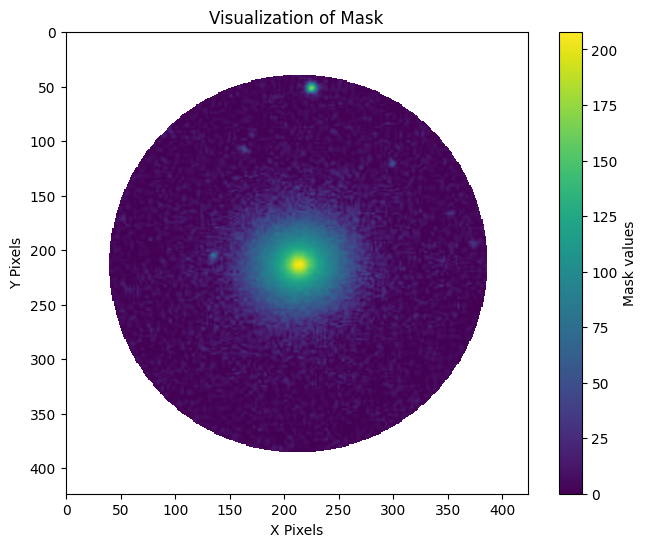

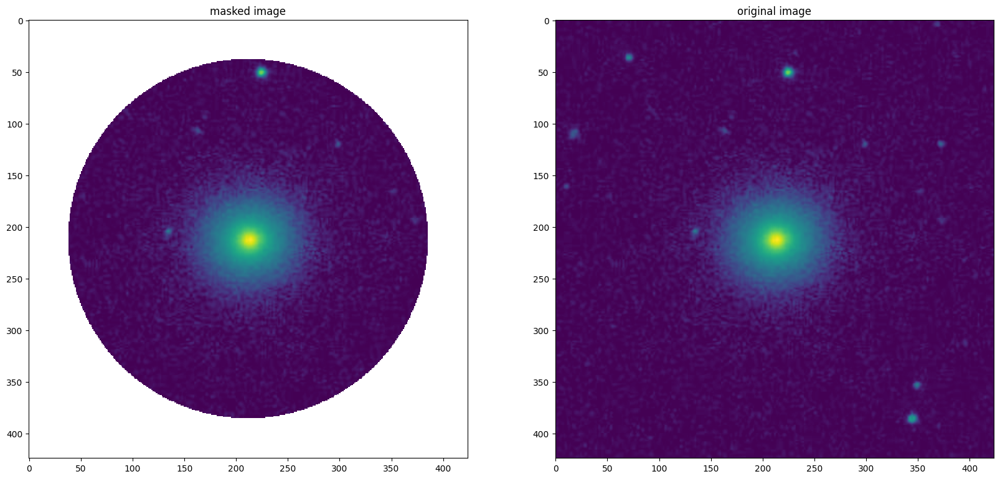

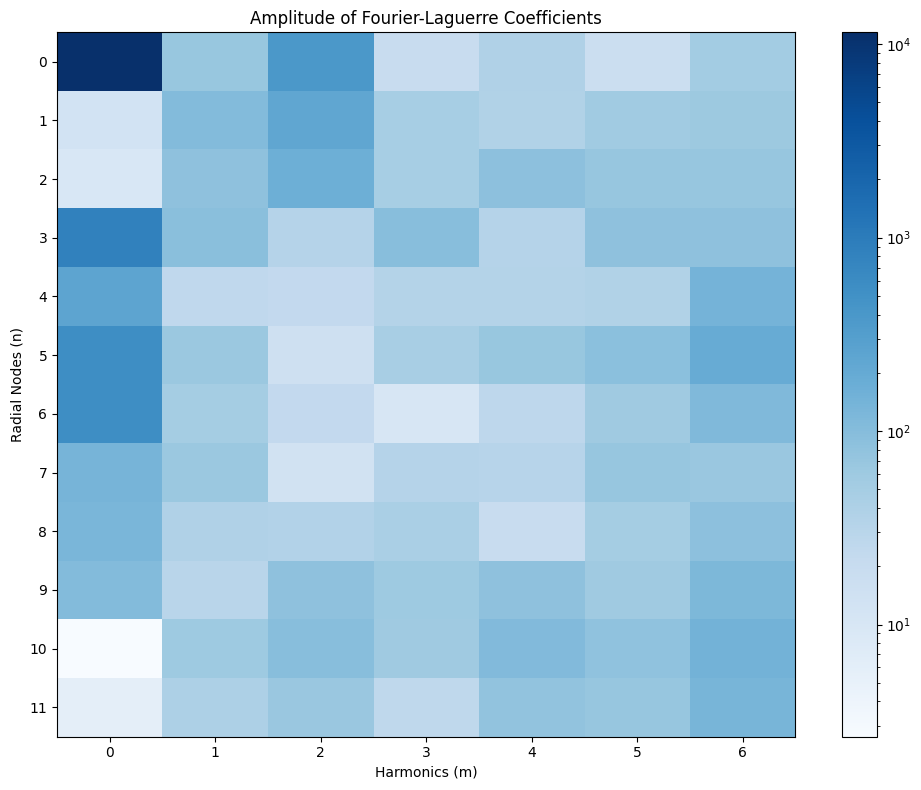

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


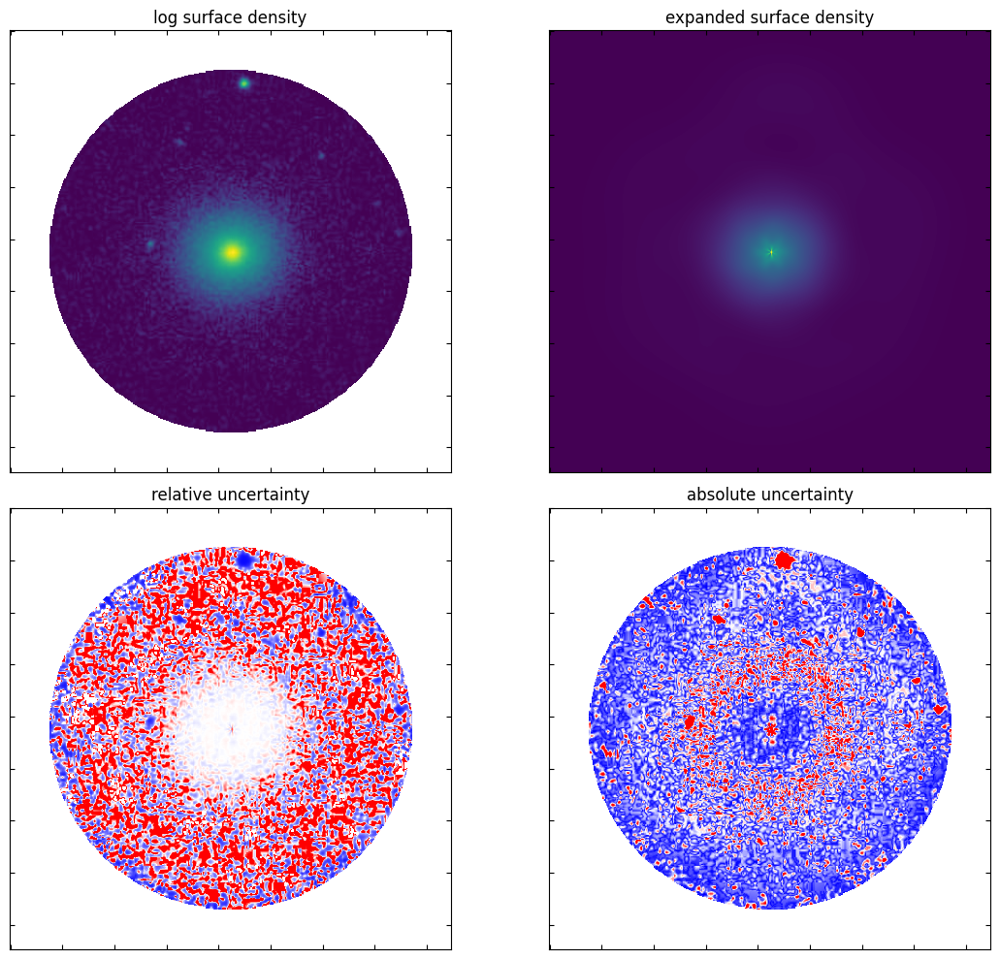

returning cosine coefficients, sine coefficients
length 0.6041666666666666
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=55, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

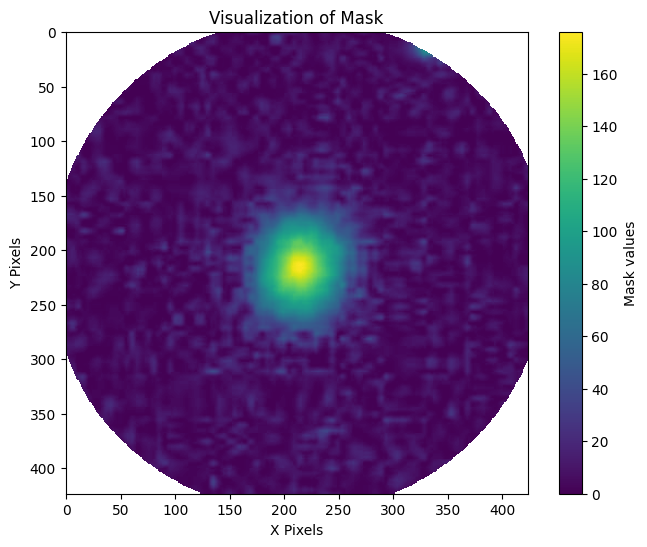

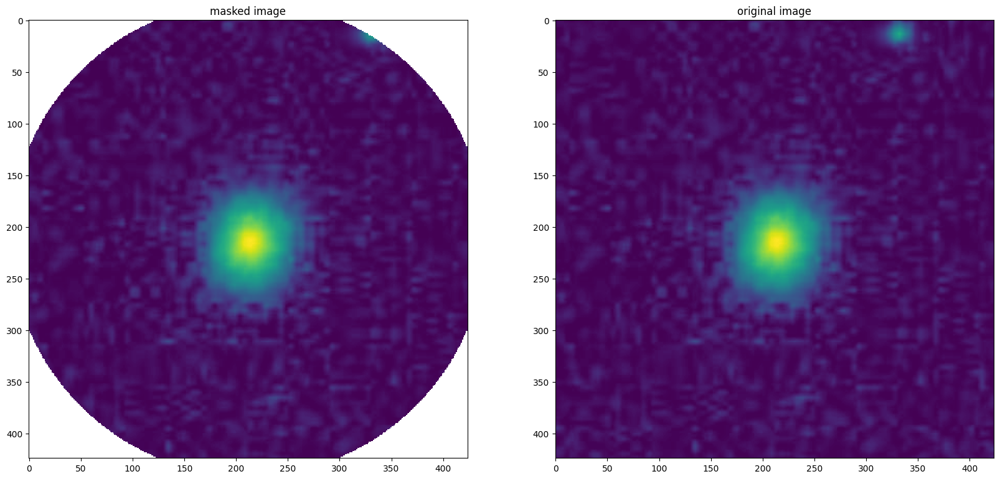

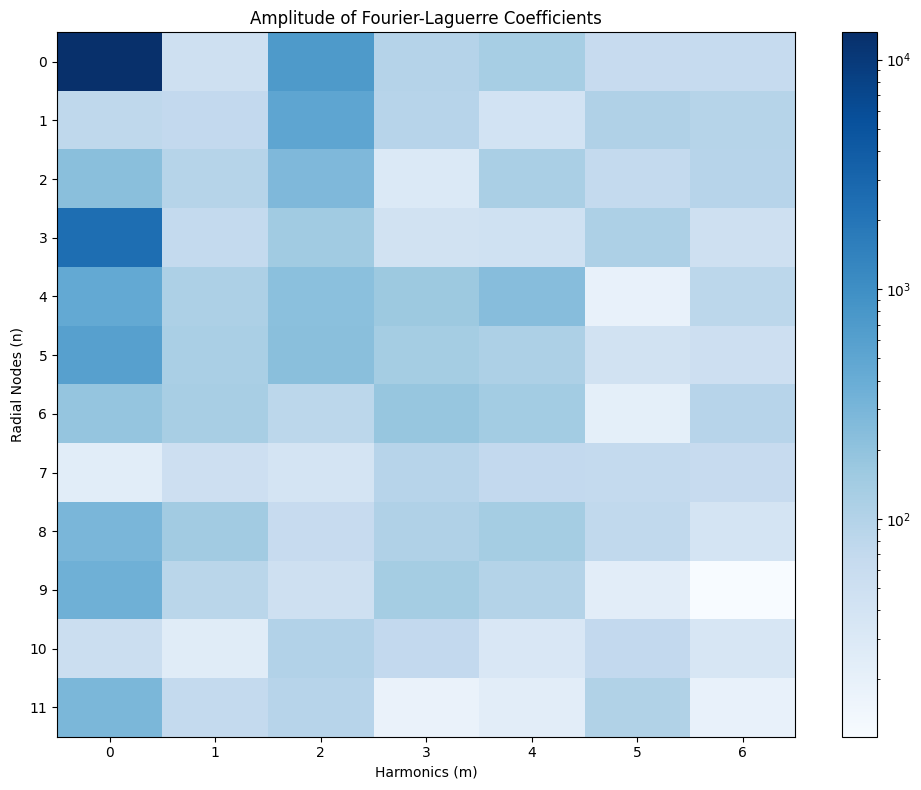

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


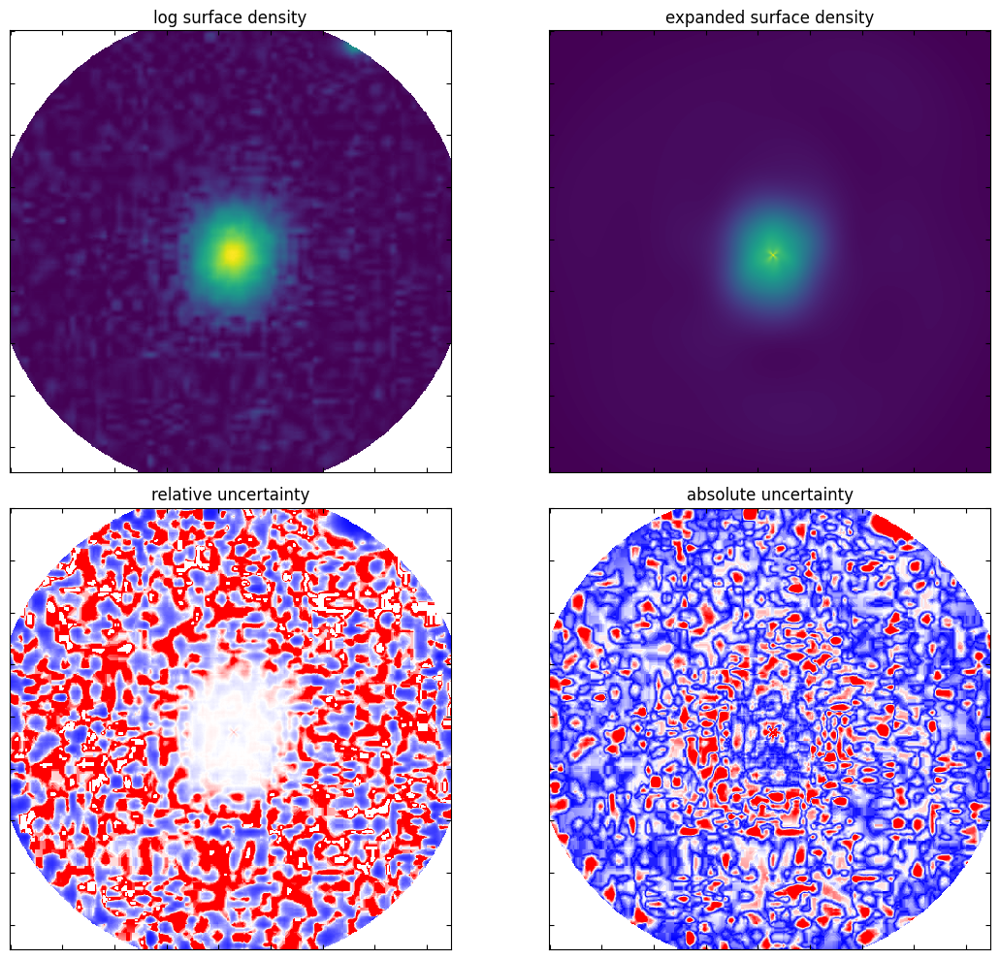

returning cosine coefficients, sine coefficients
length 0.9375
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

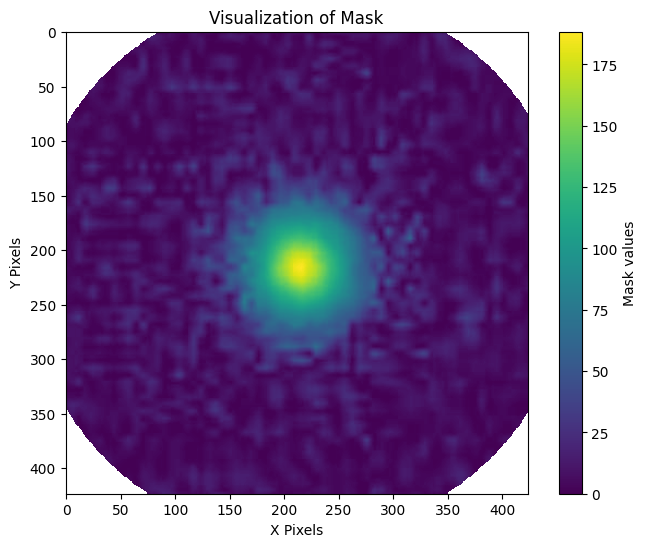

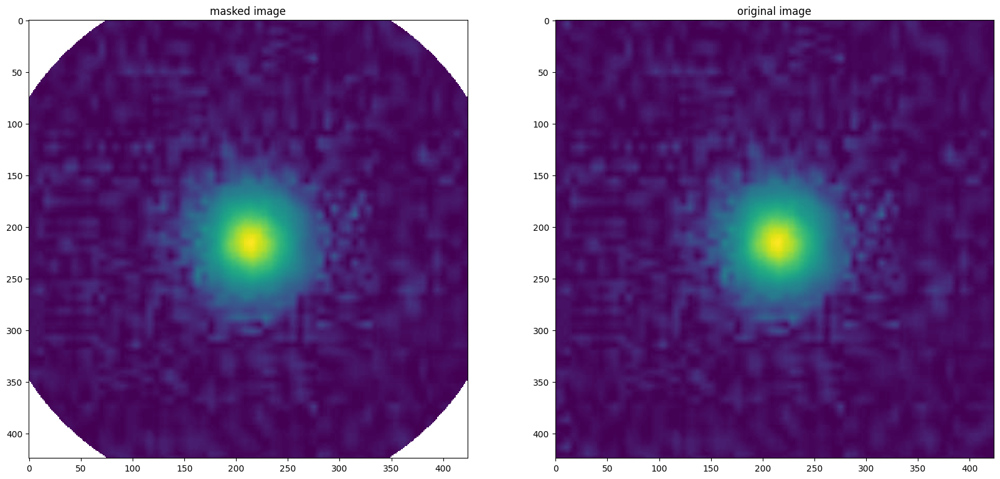

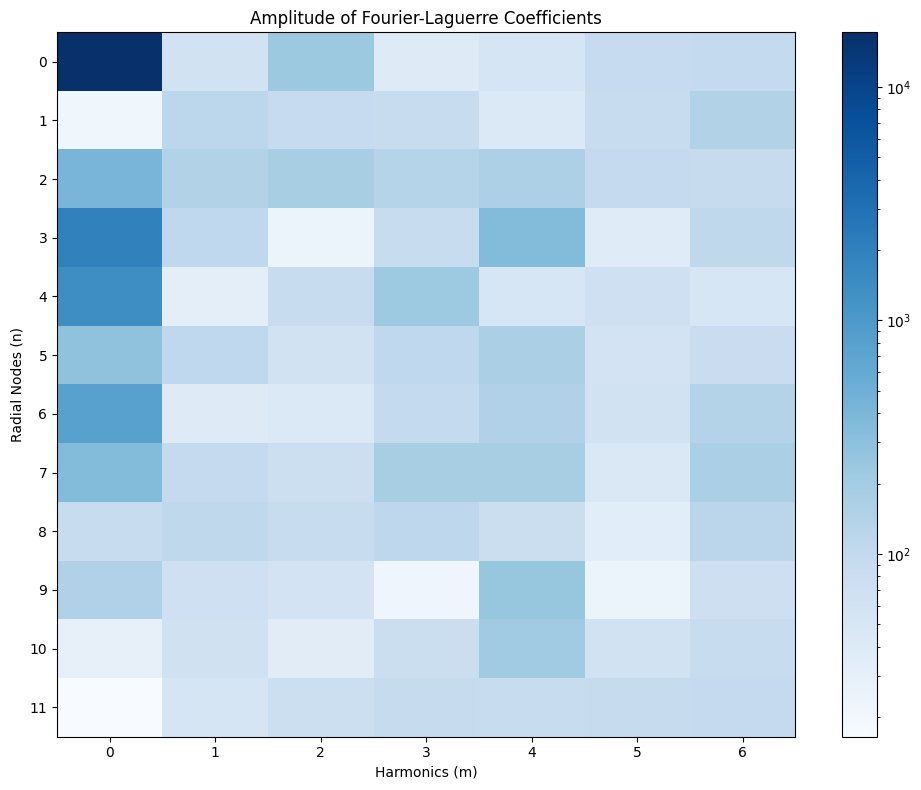

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


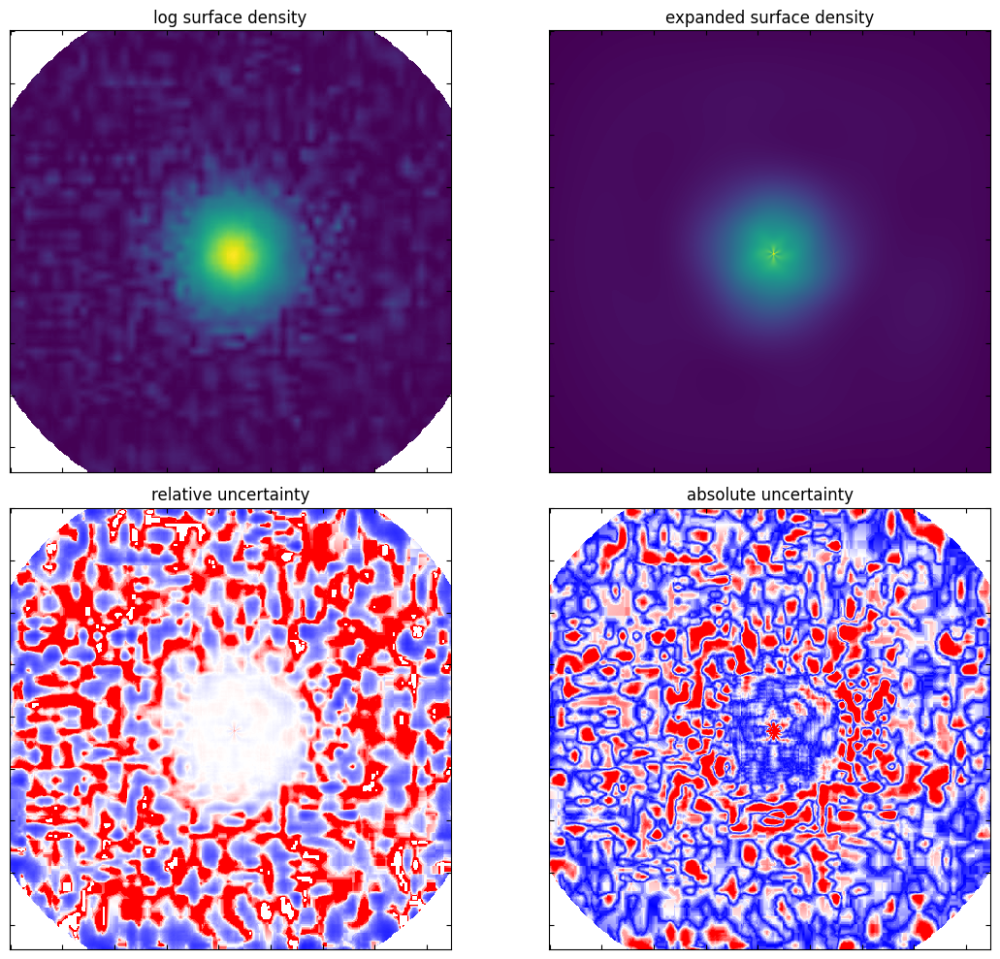

returning cosine coefficients, sine coefficients
length 0.6041666666666666
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

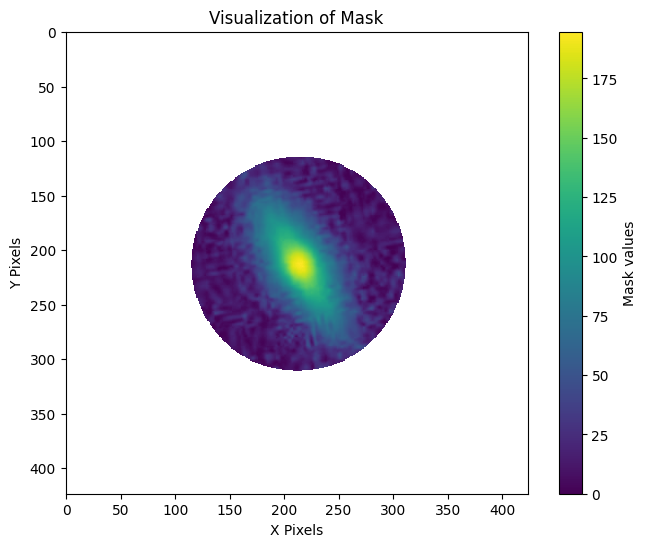

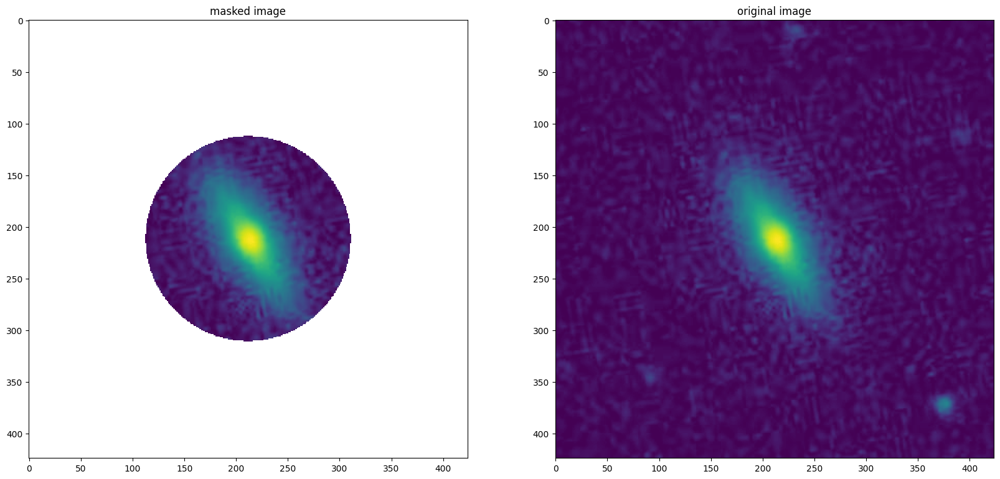

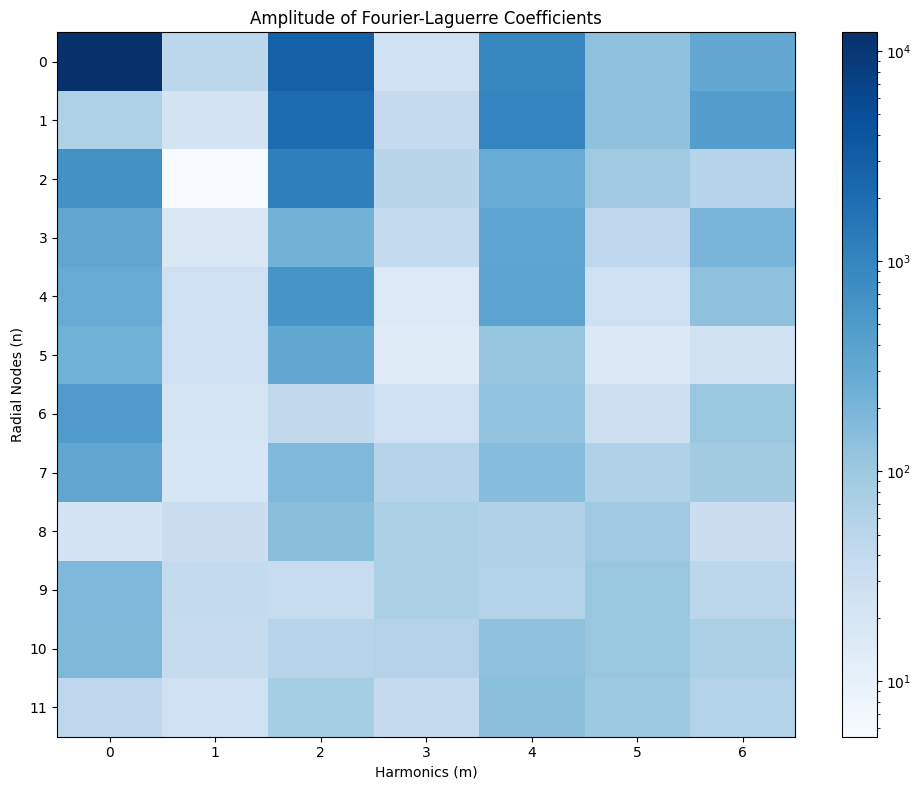

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


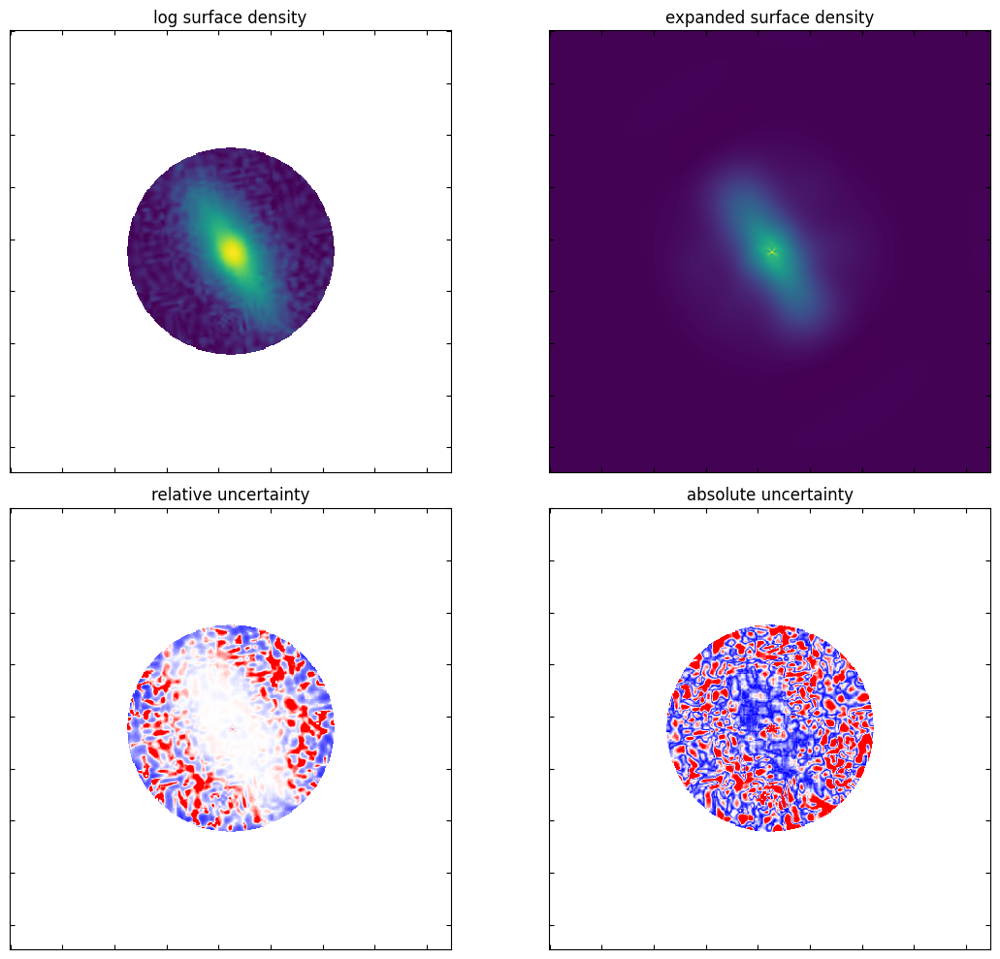

returning cosine coefficients, sine coefficients
length 1.3125
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

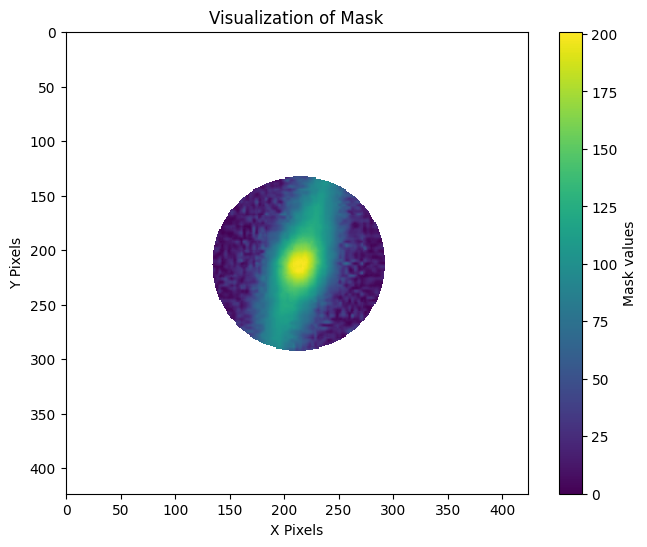

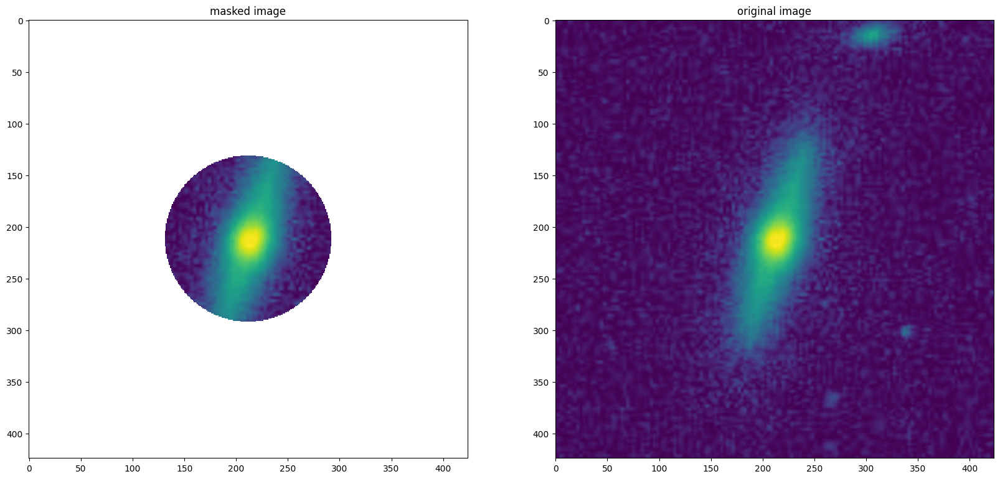

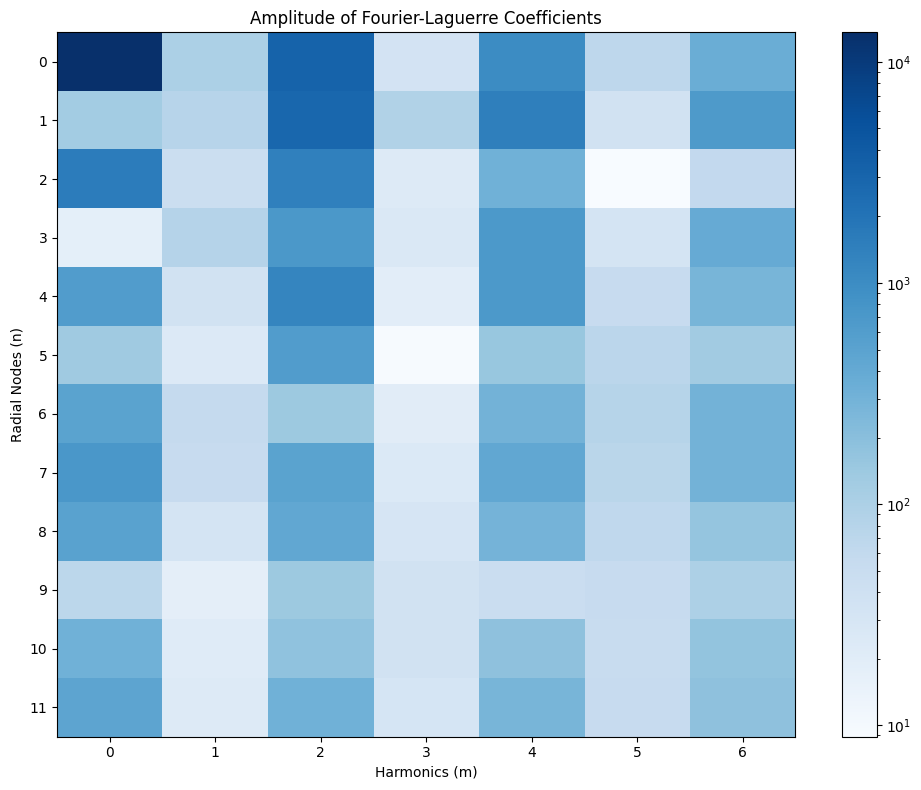

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


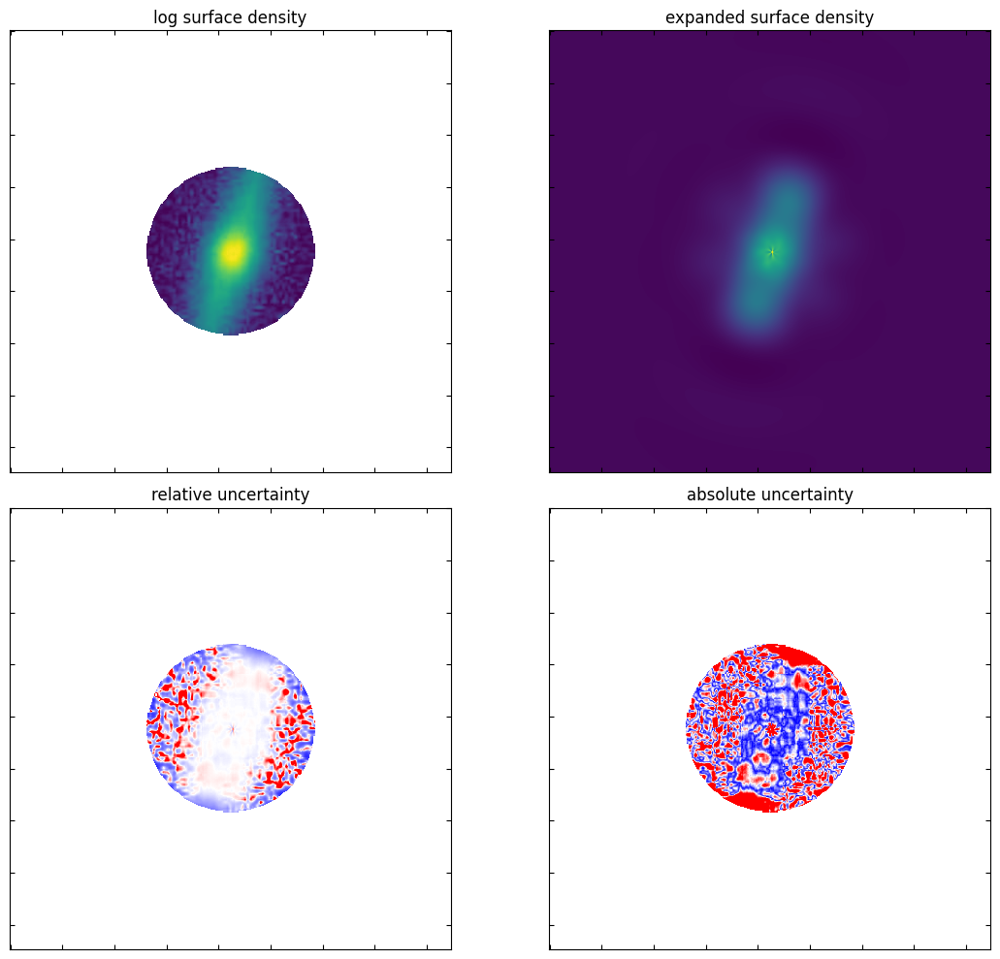

returning cosine coefficients, sine coefficients
length 1.6458333333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=55, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

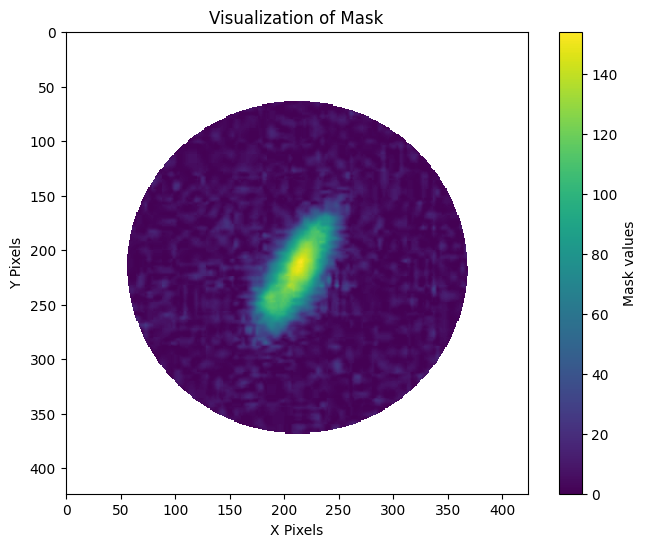

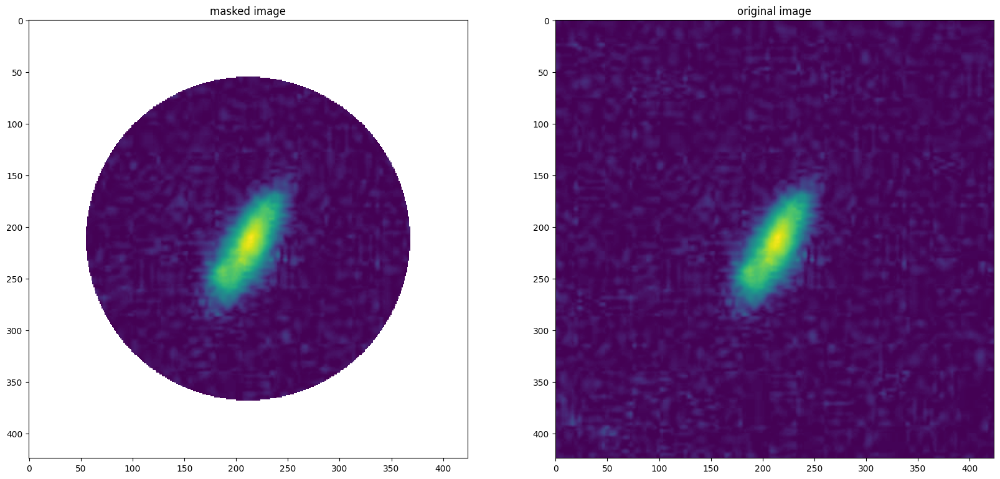

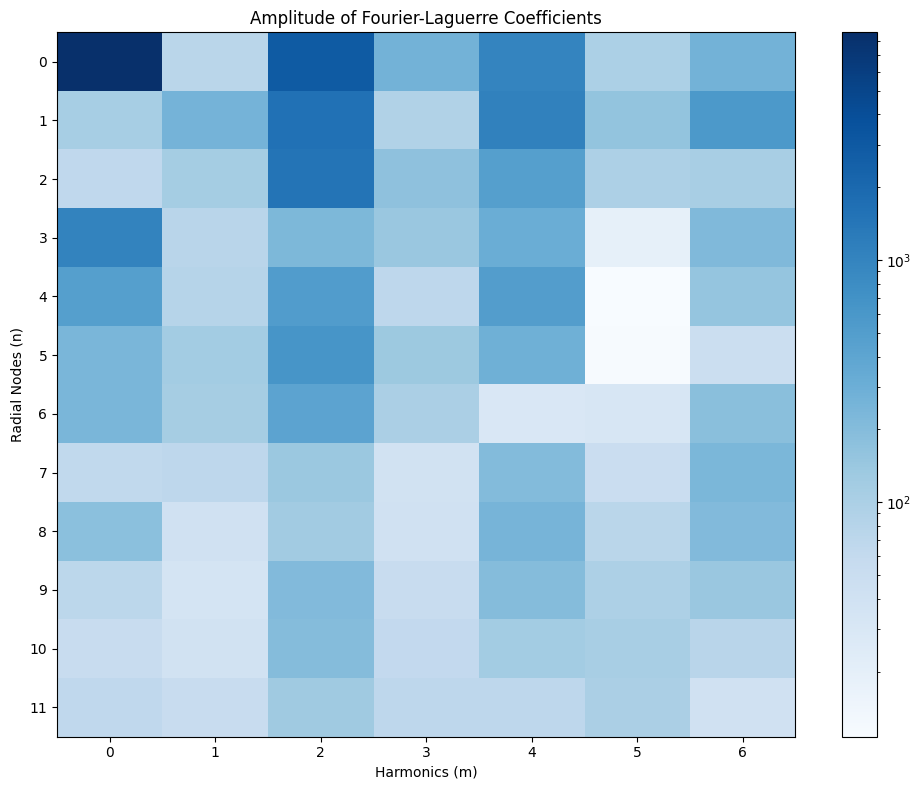

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


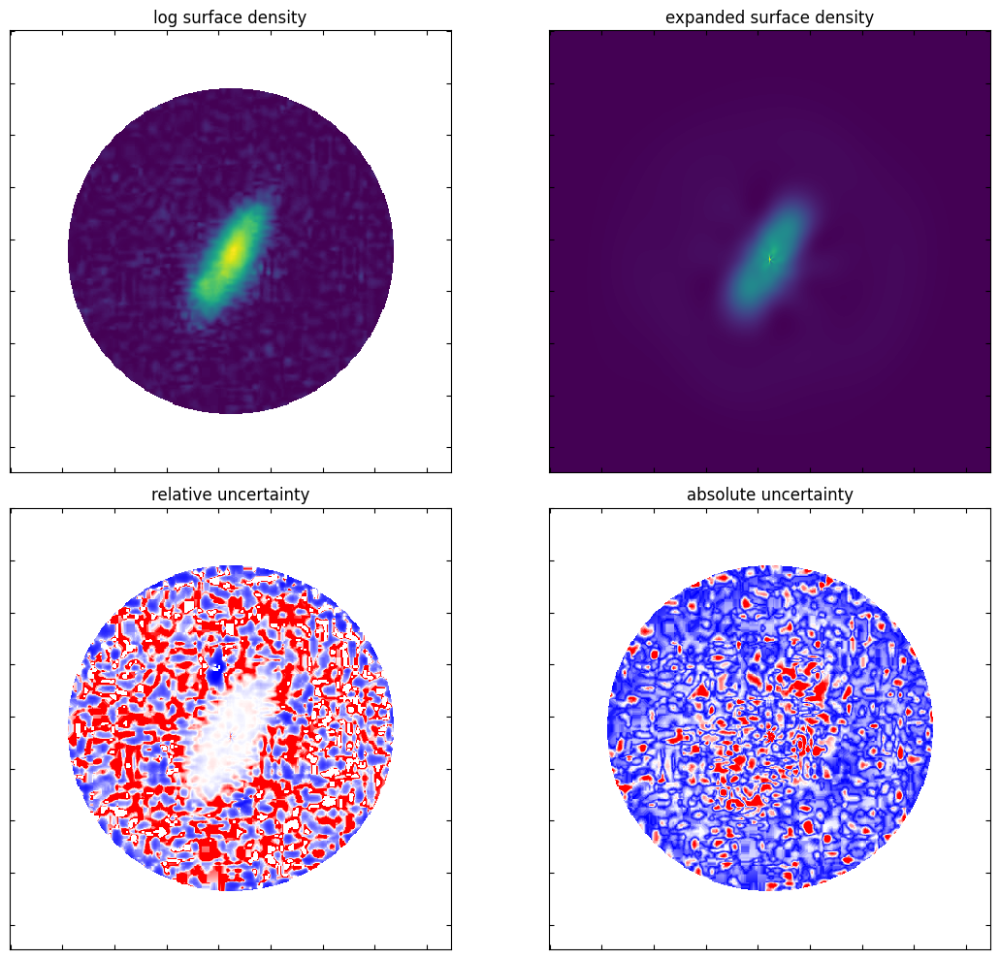

returning cosine coefficients, sine coefficients
length 2.2291666666666665
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=58, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

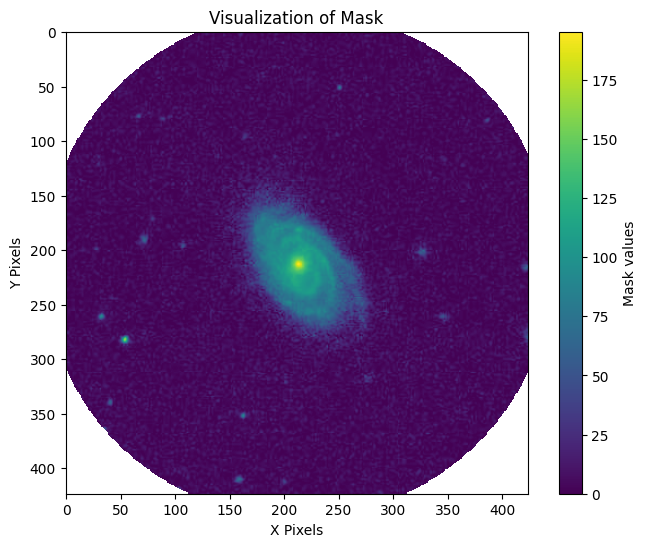

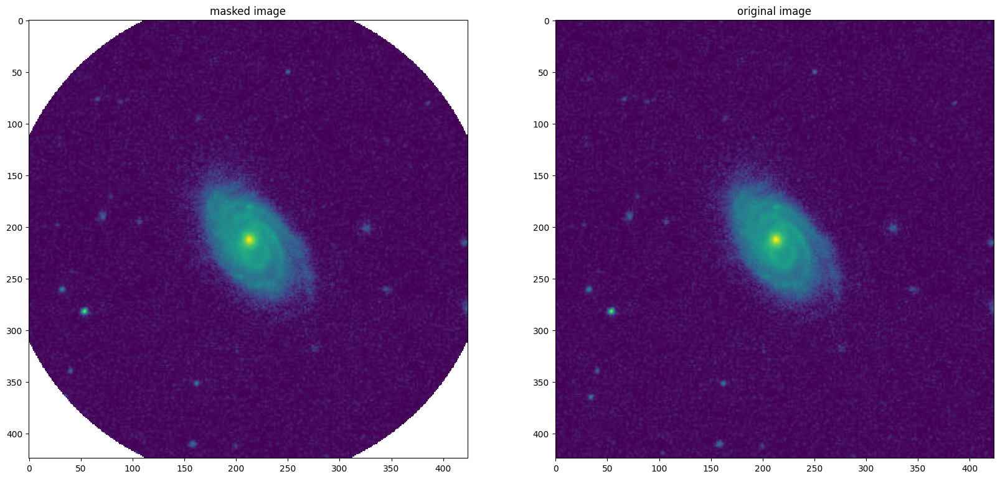

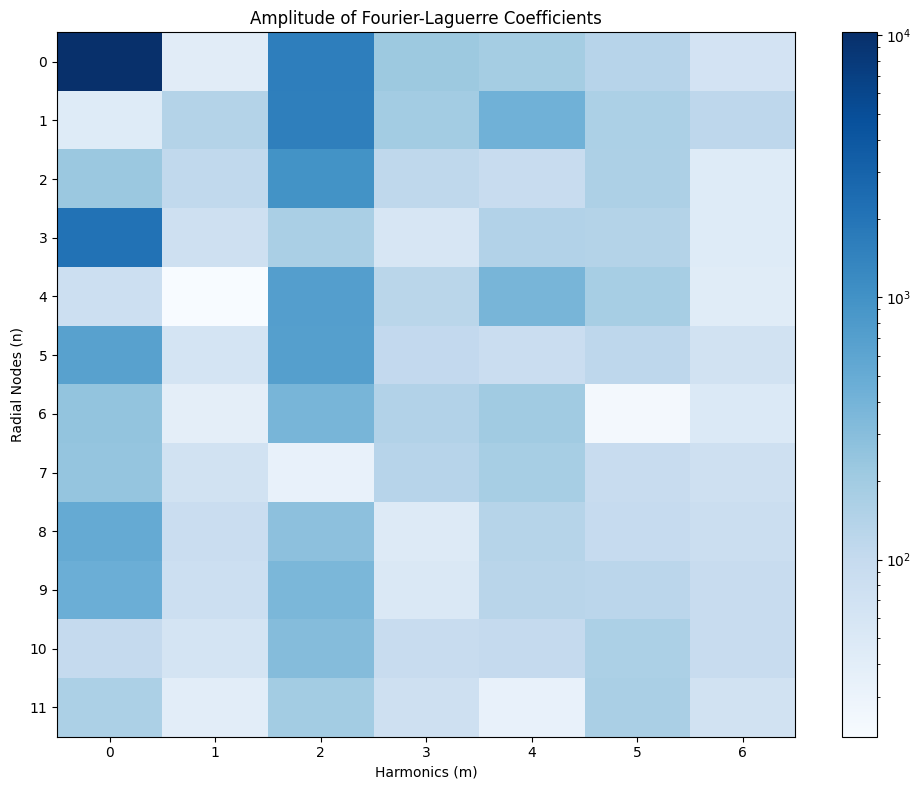

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


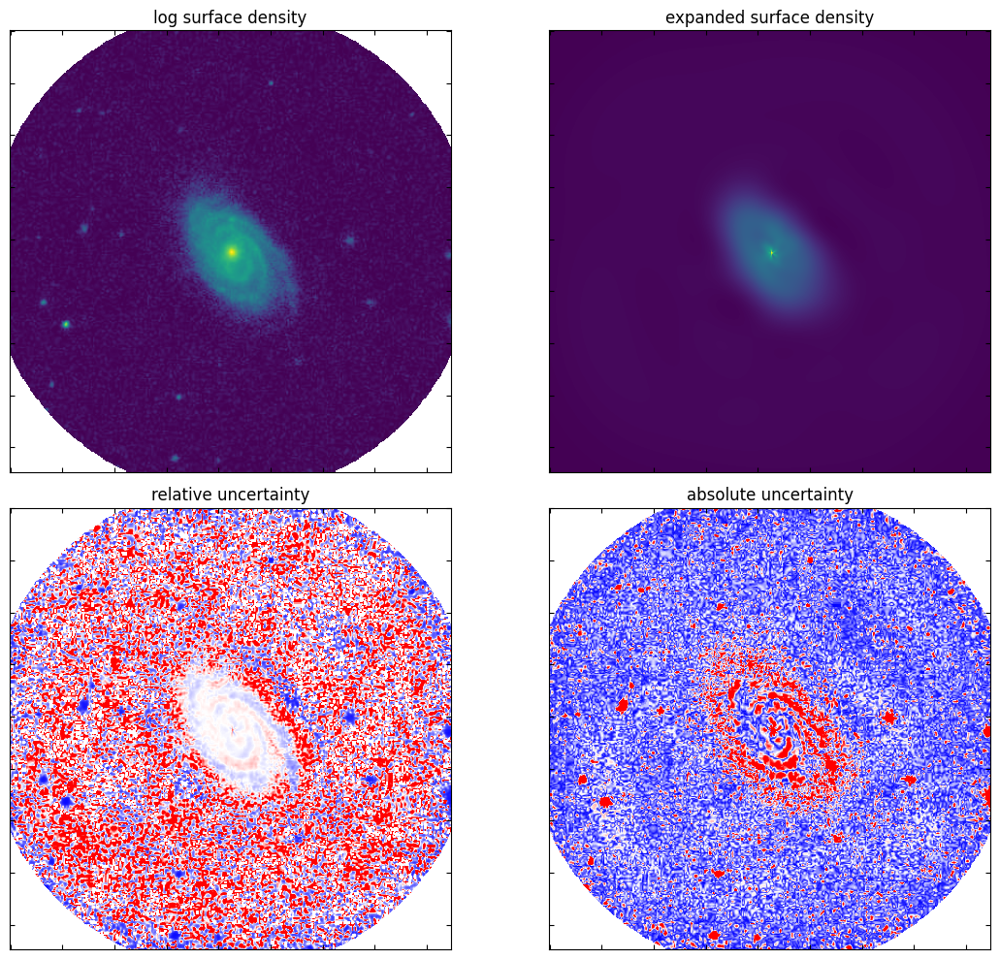

returning cosine coefficients, sine coefficients
length 1.9375
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

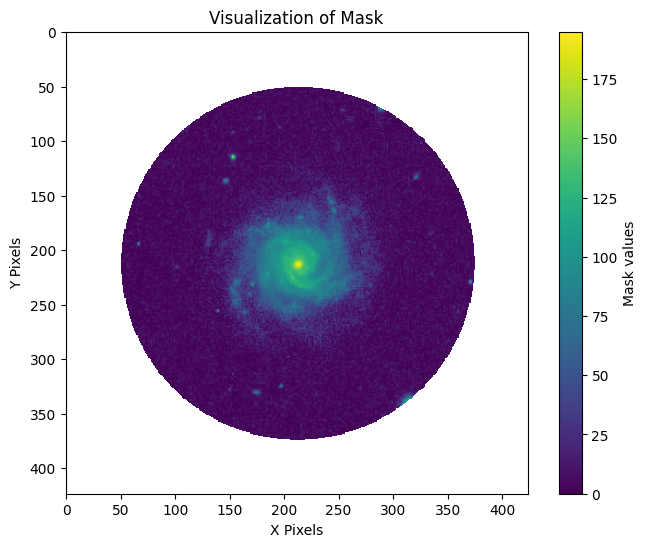

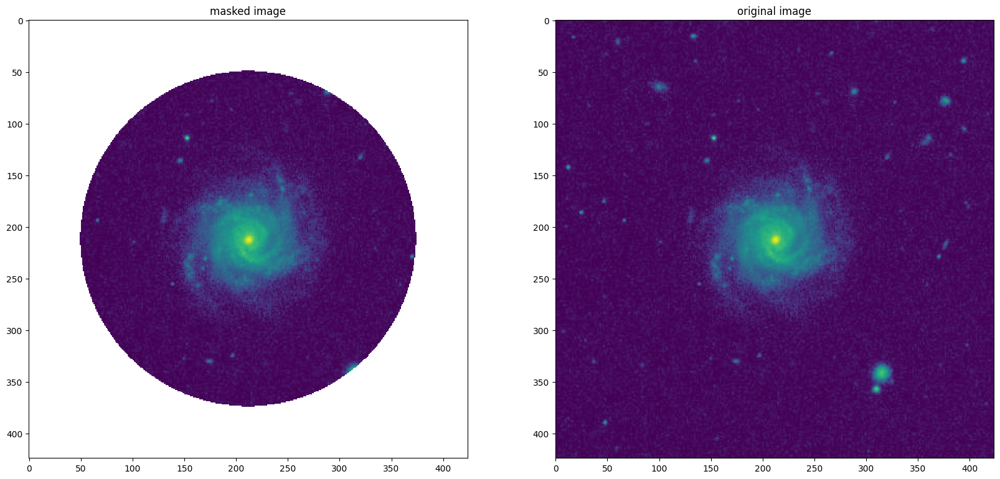

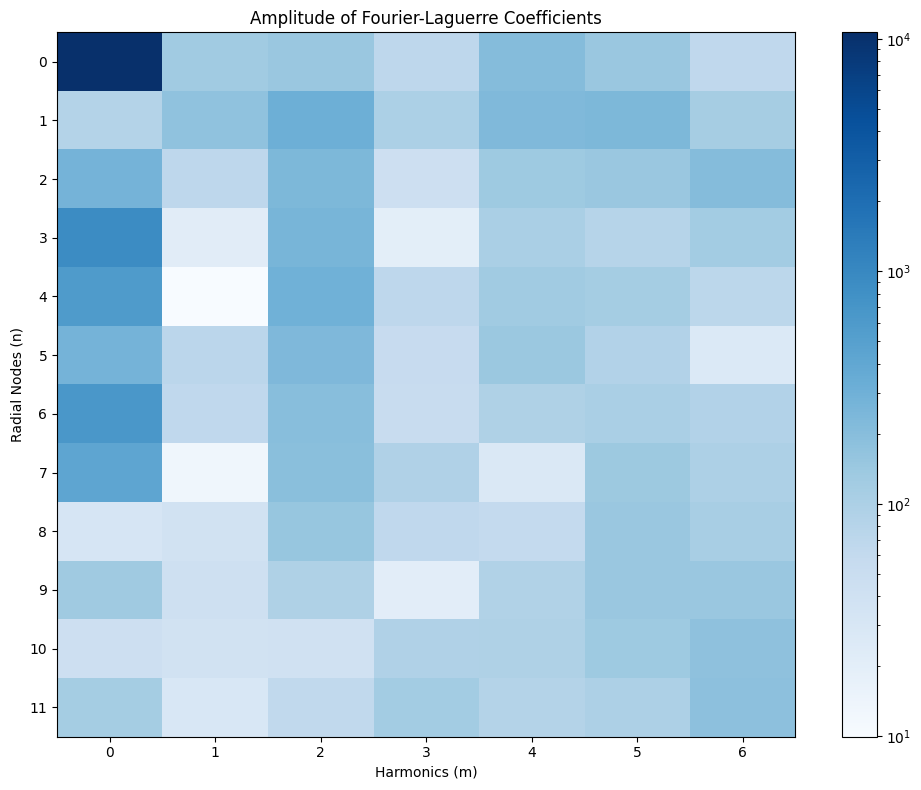

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


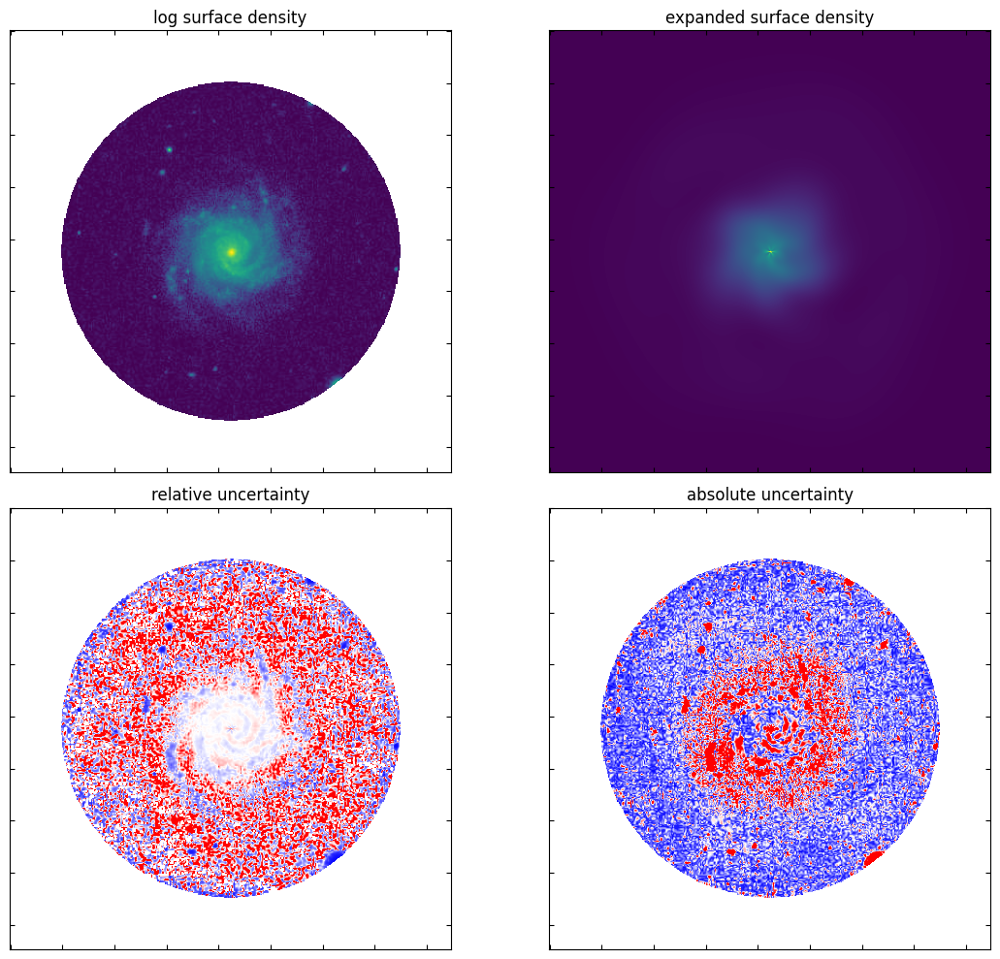

returning cosine coefficients, sine coefficients
length 1.6875
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

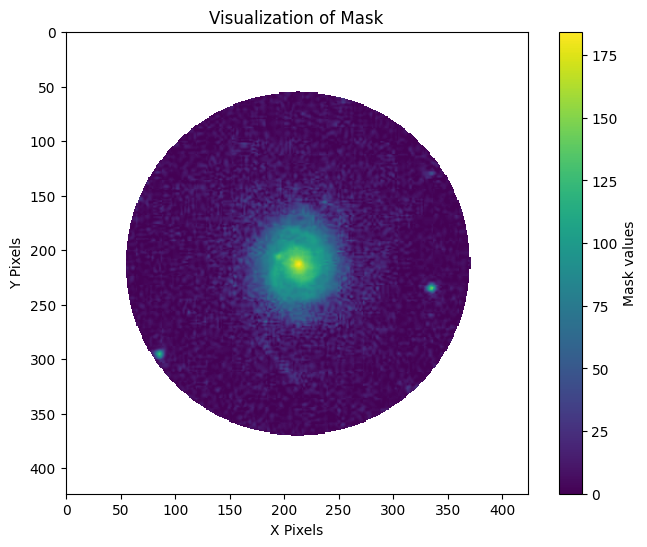

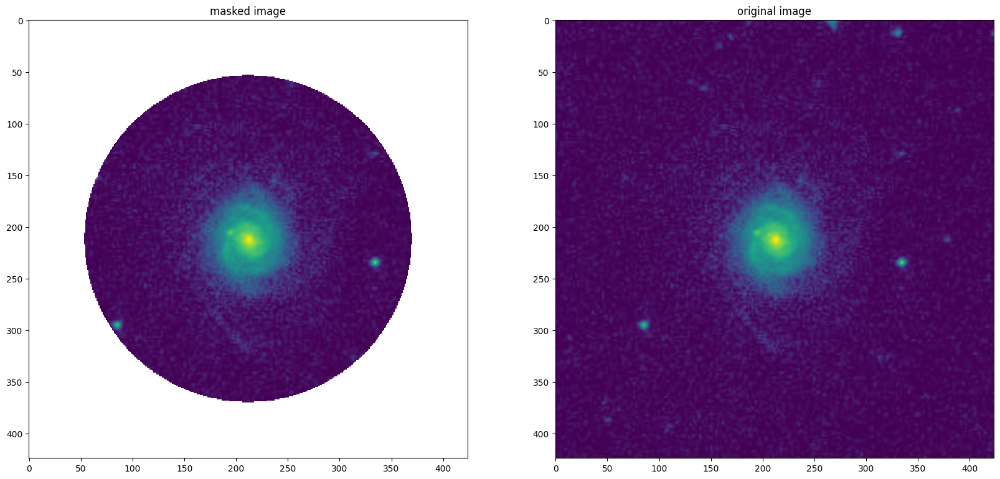

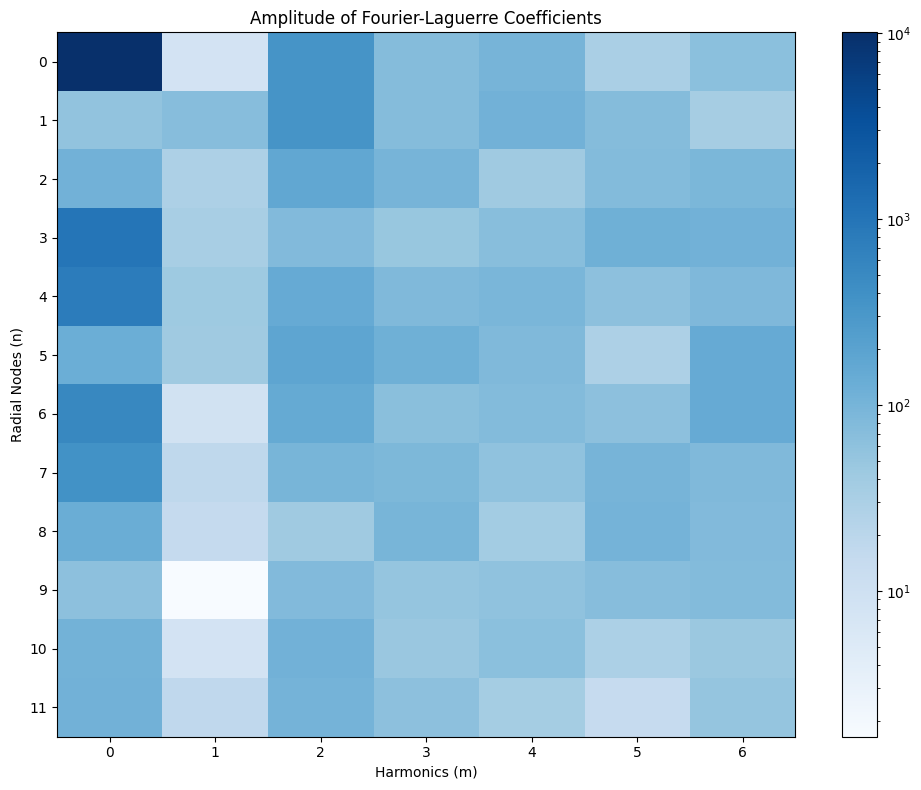

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


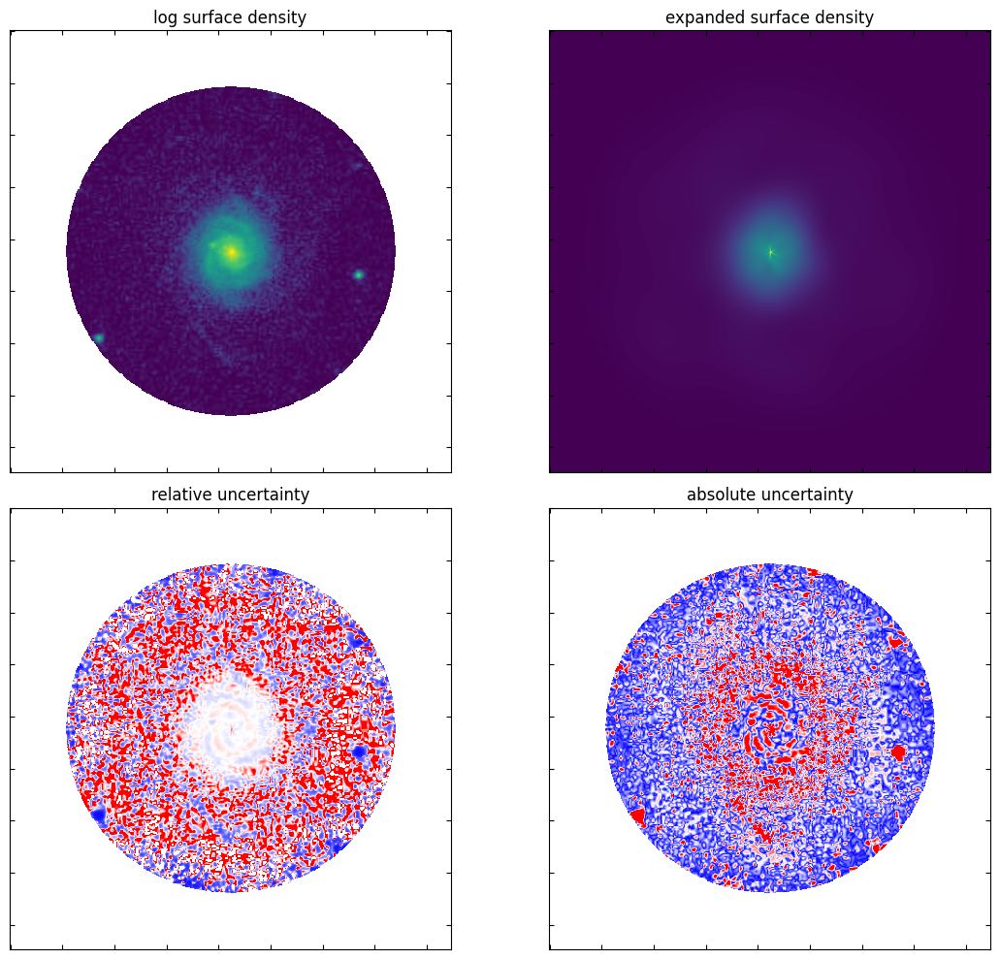

returning cosine coefficients, sine coefficients
length 1.0625
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

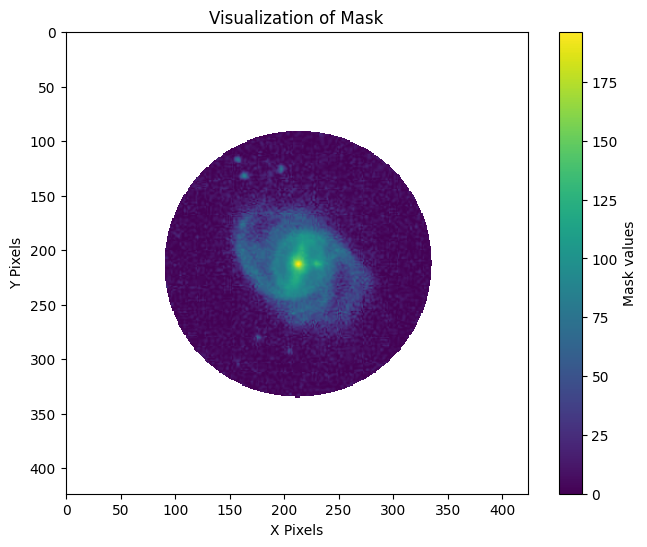

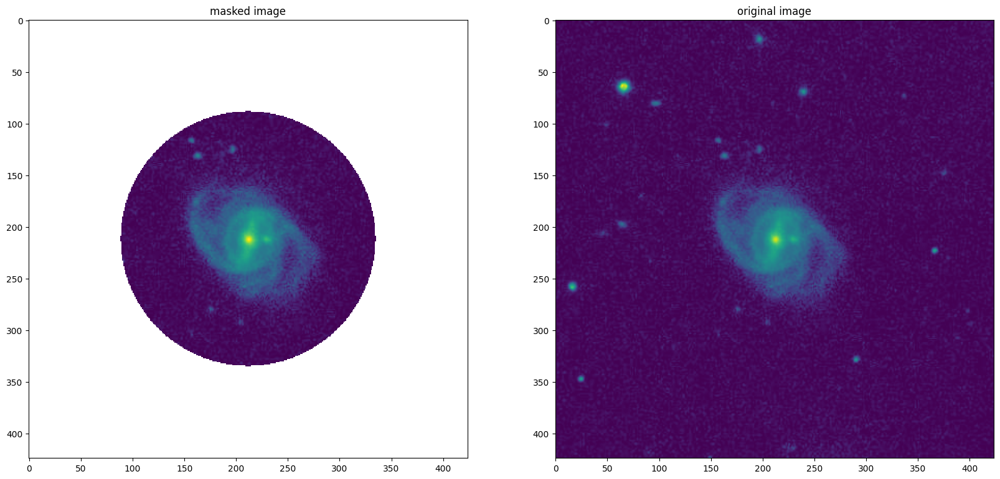

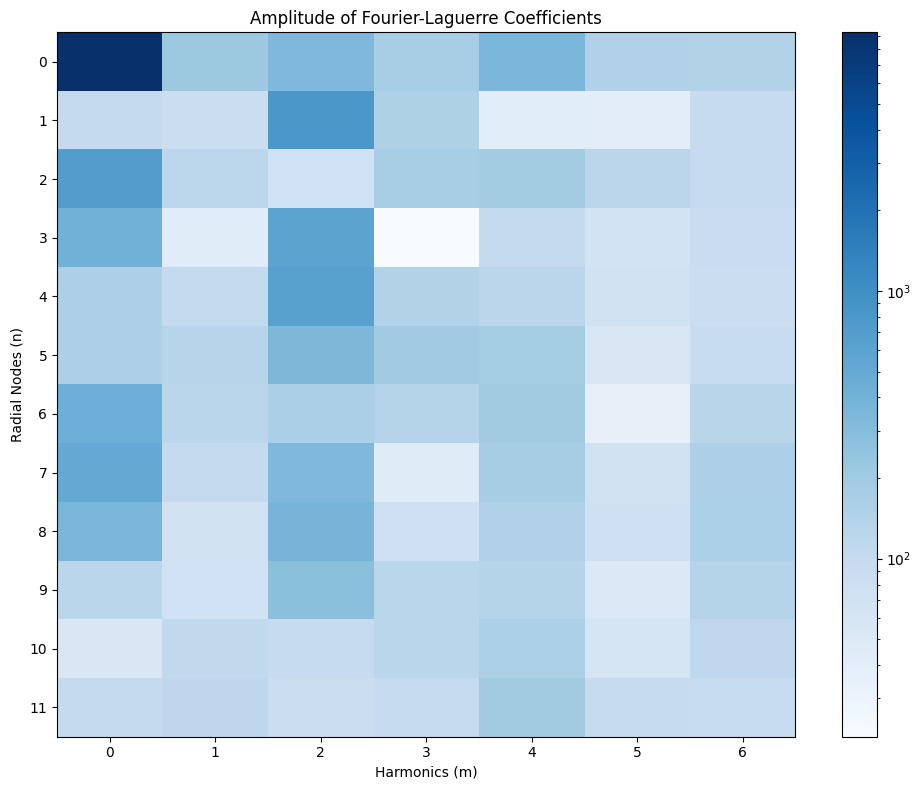

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


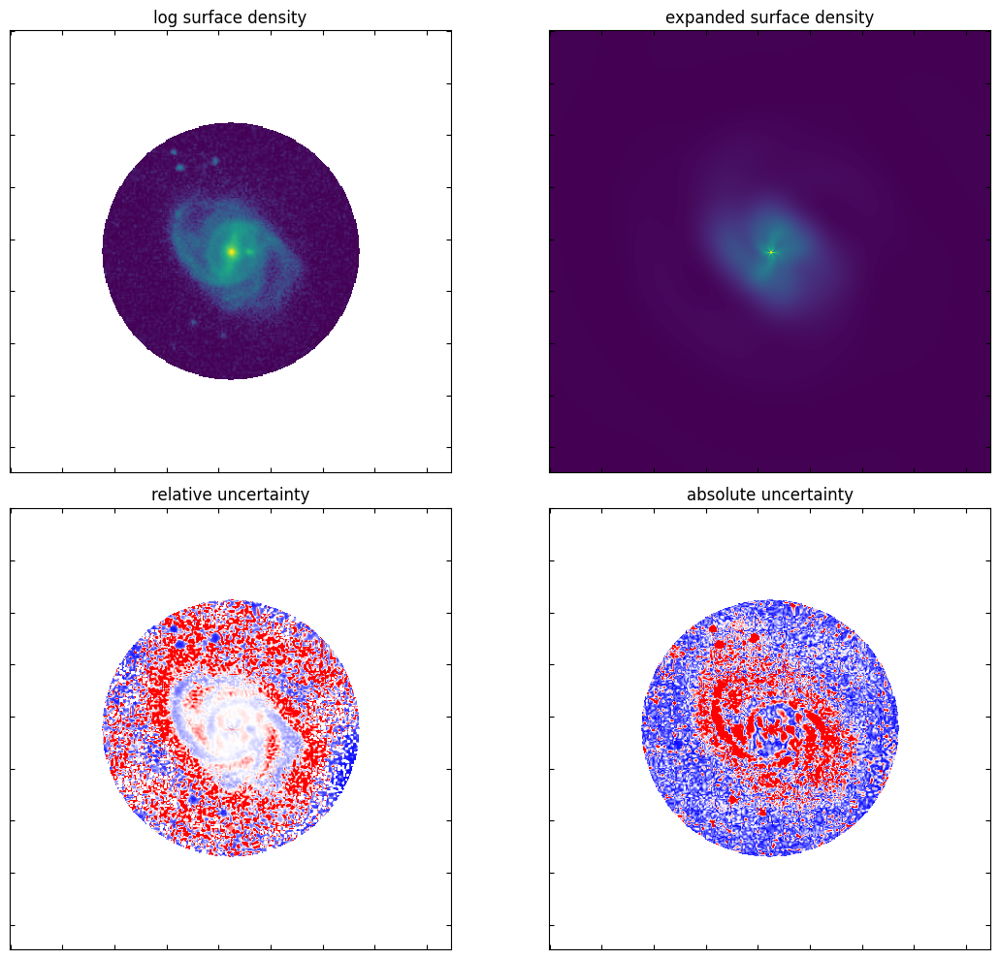

returning cosine coefficients, sine coefficients
length 2.520833333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=58, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloci

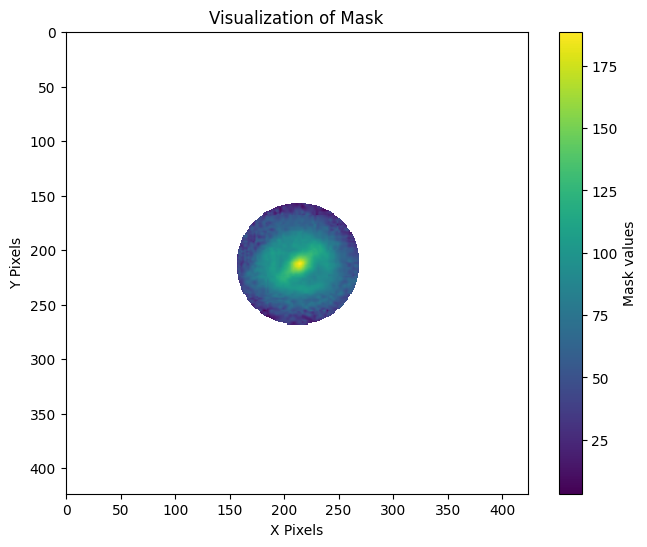

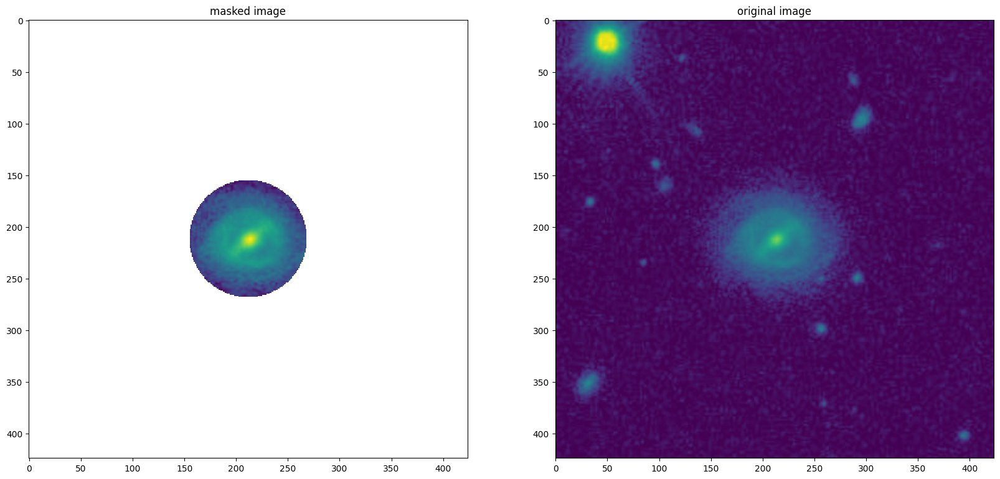

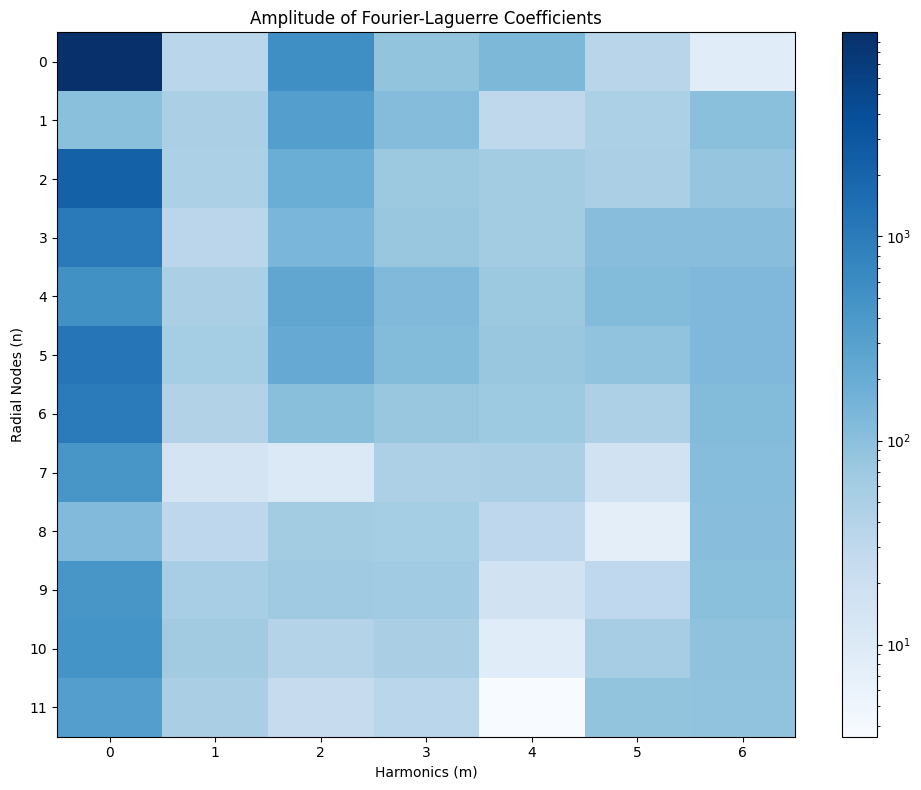

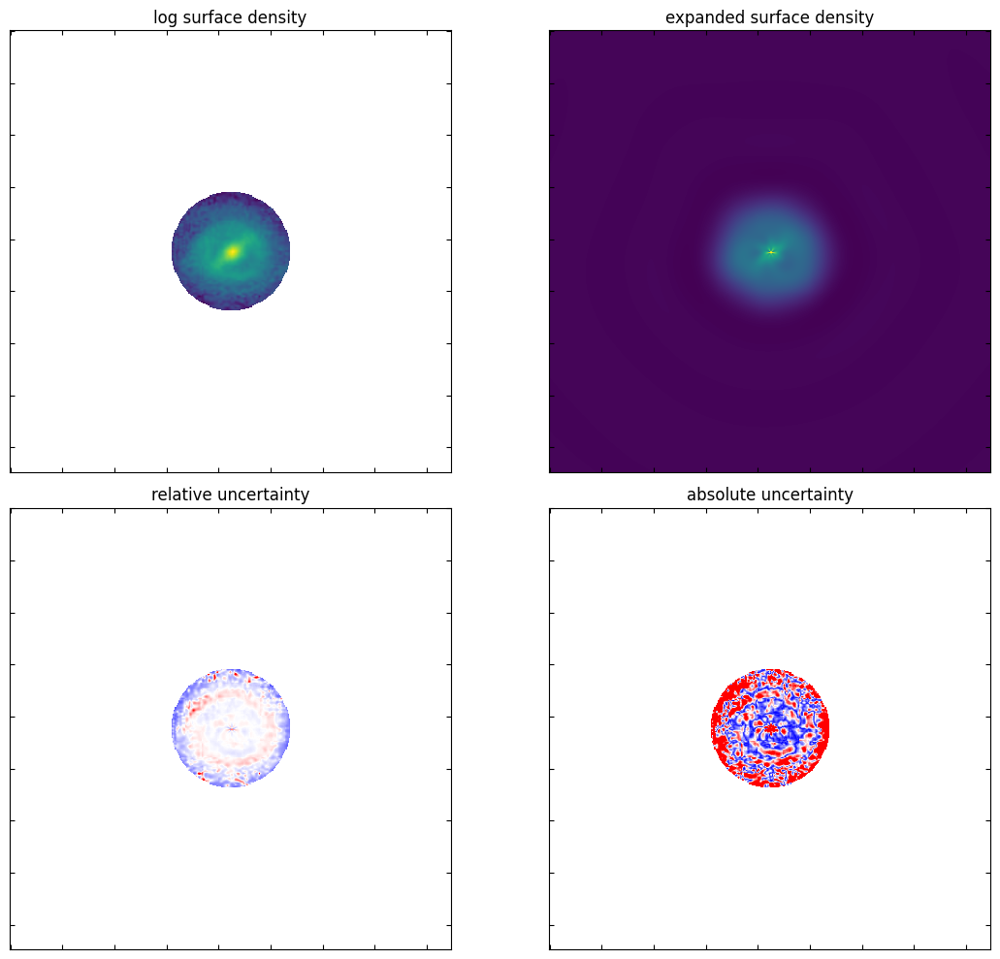

returning cosine coefficients, sine coefficients
length 1.2708333333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=58, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

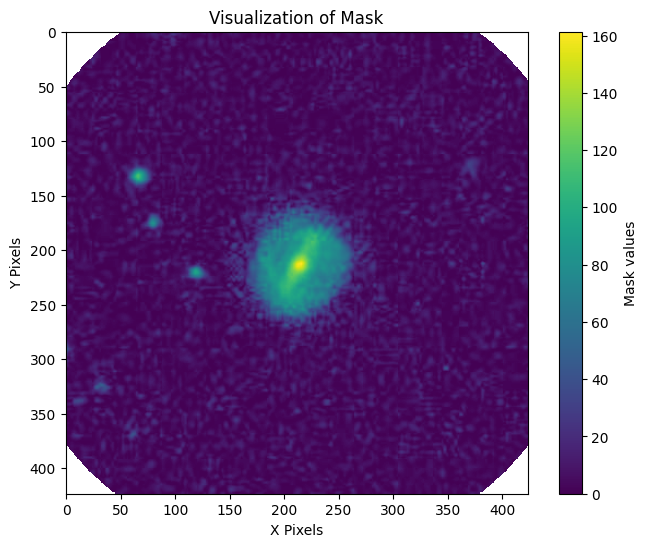

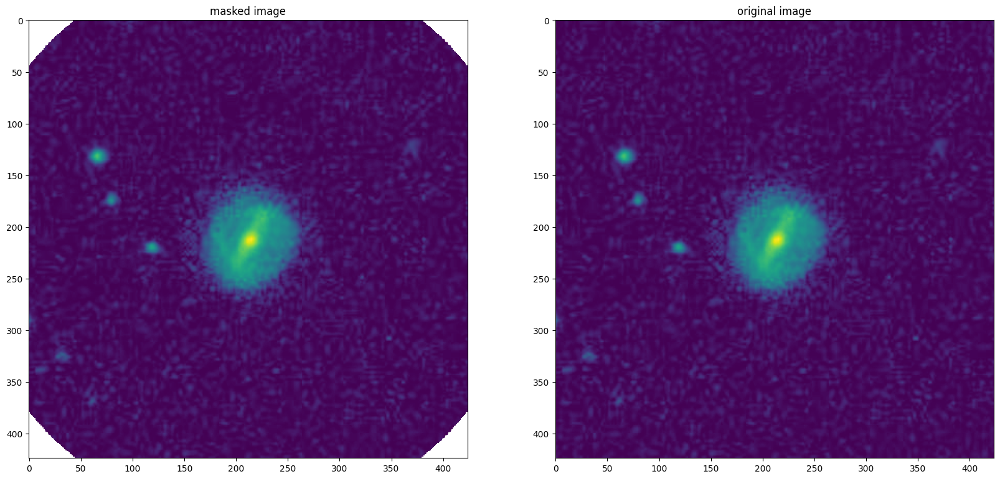

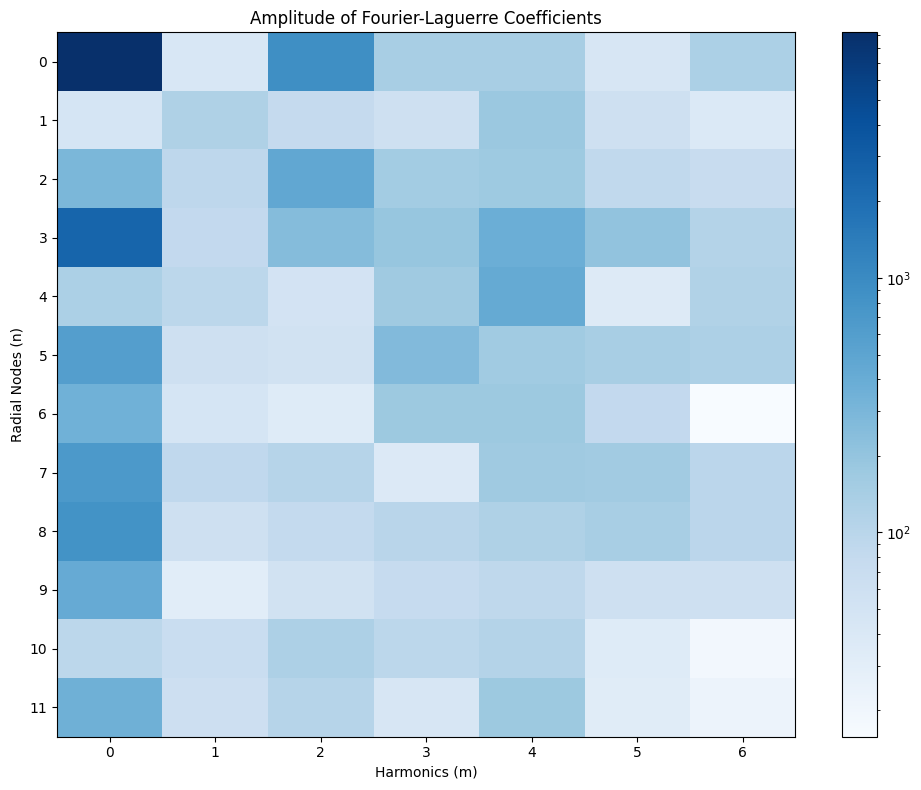

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


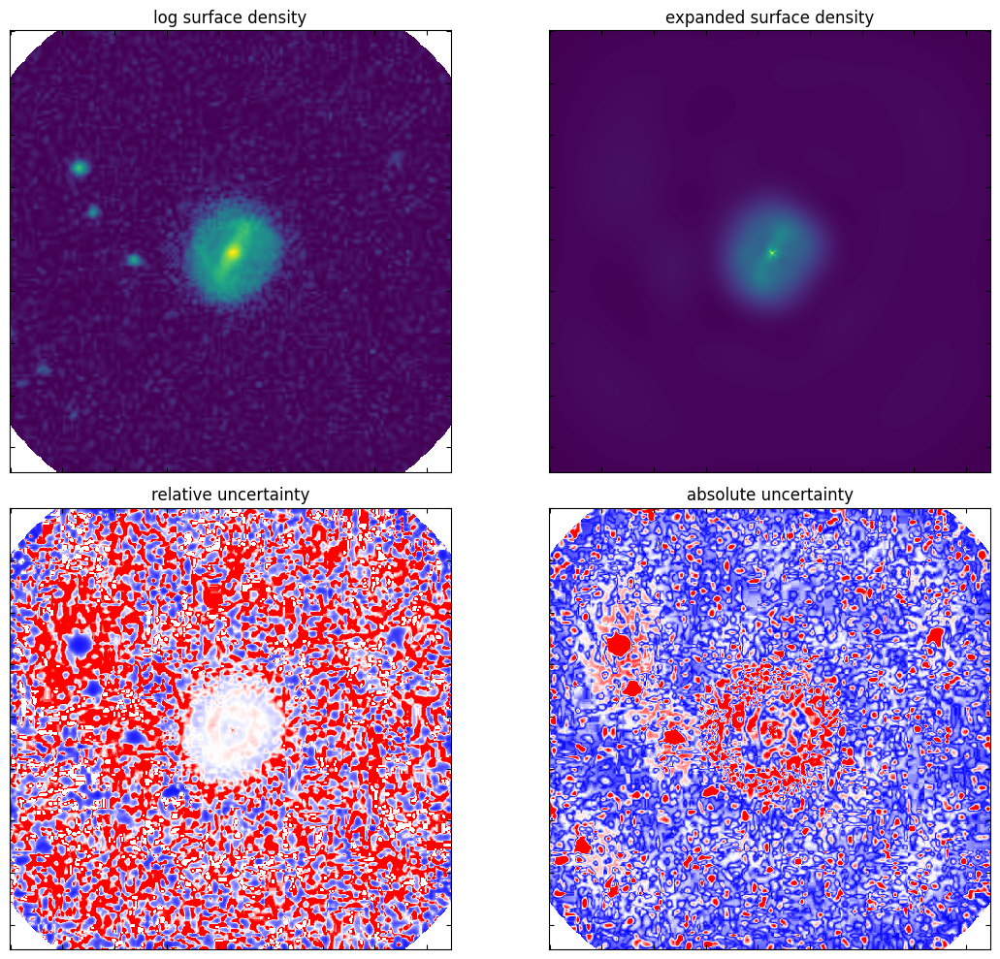

returning cosine coefficients, sine coefficients
length 1.9791666666666665
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

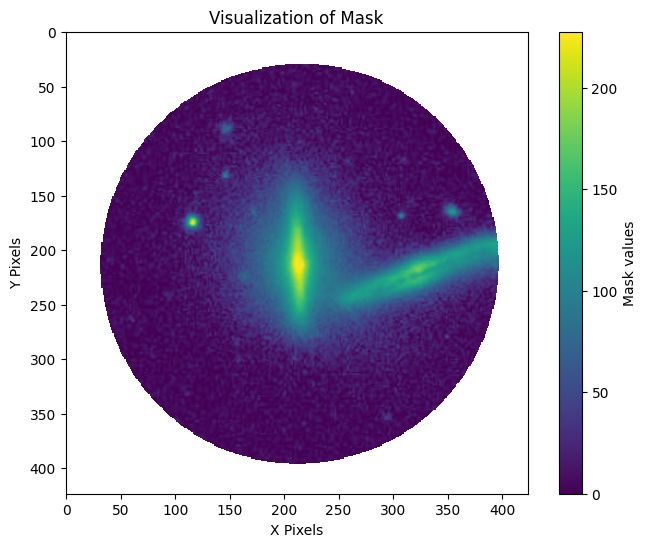

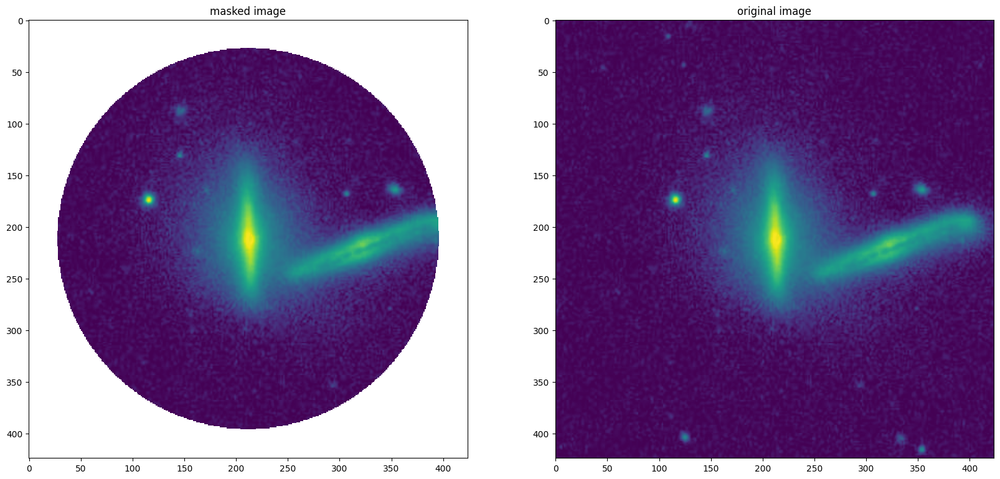

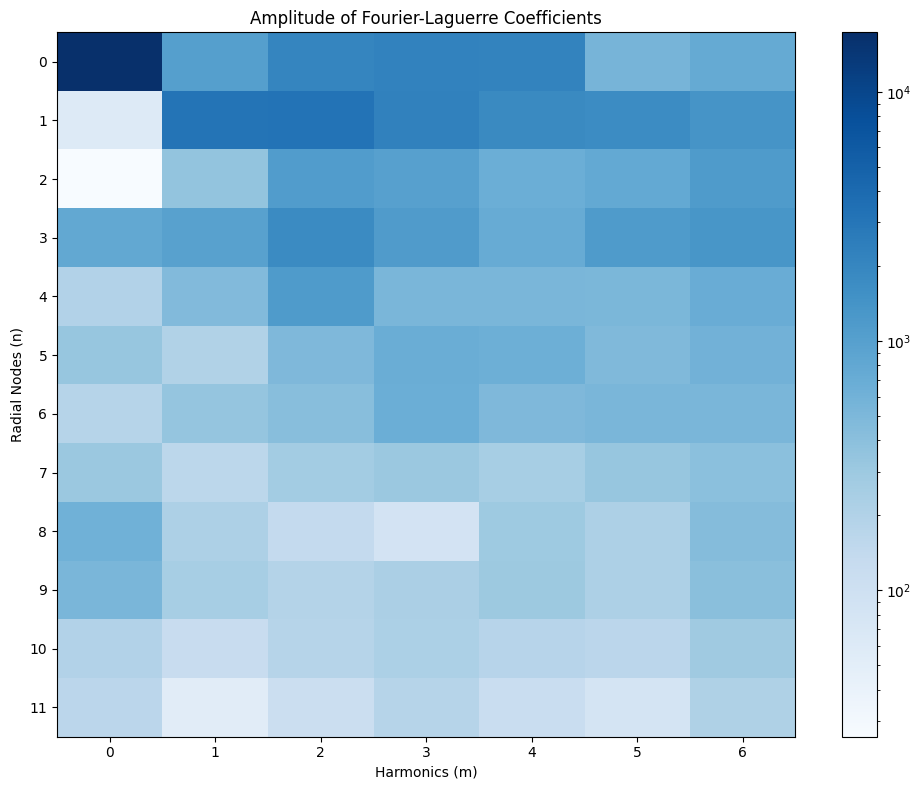

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


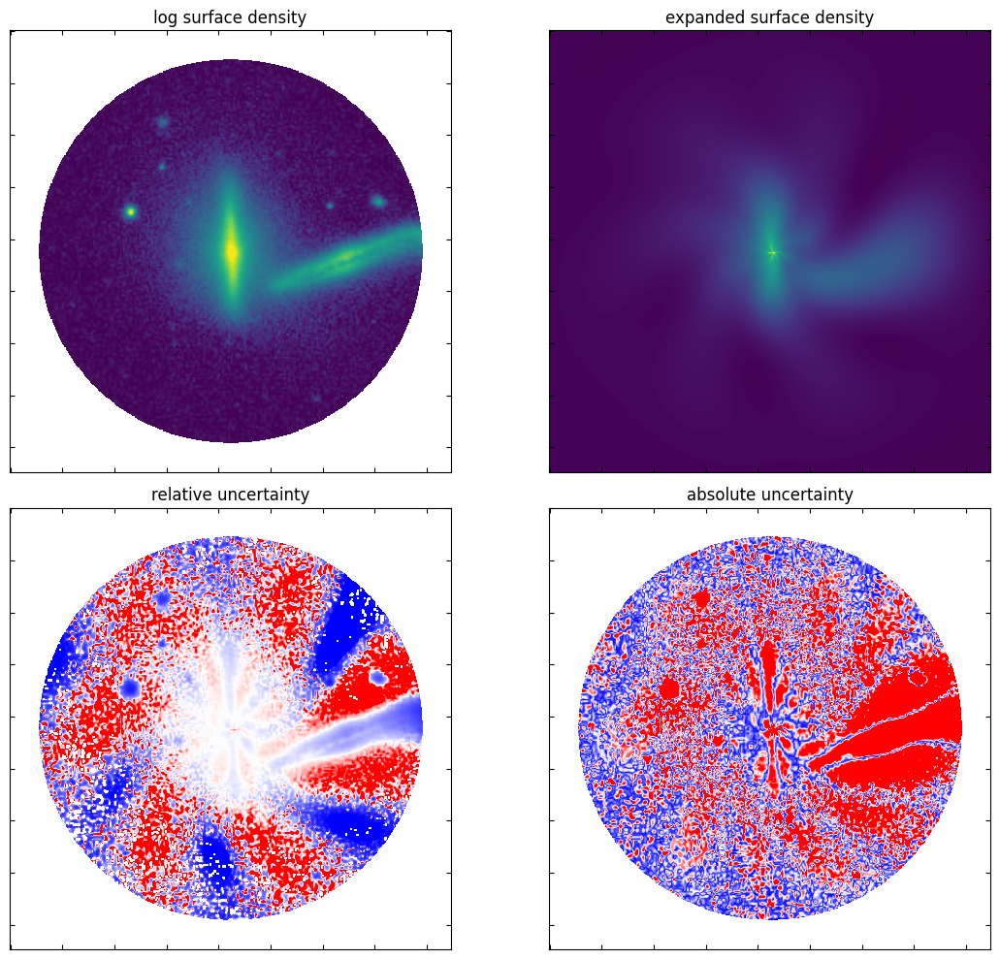

returning cosine coefficients, sine coefficients
length 2.9791666666666665
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=55, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloc

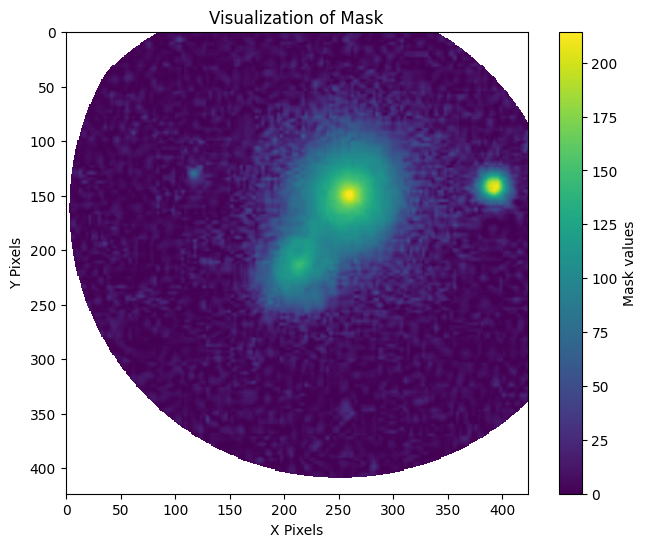

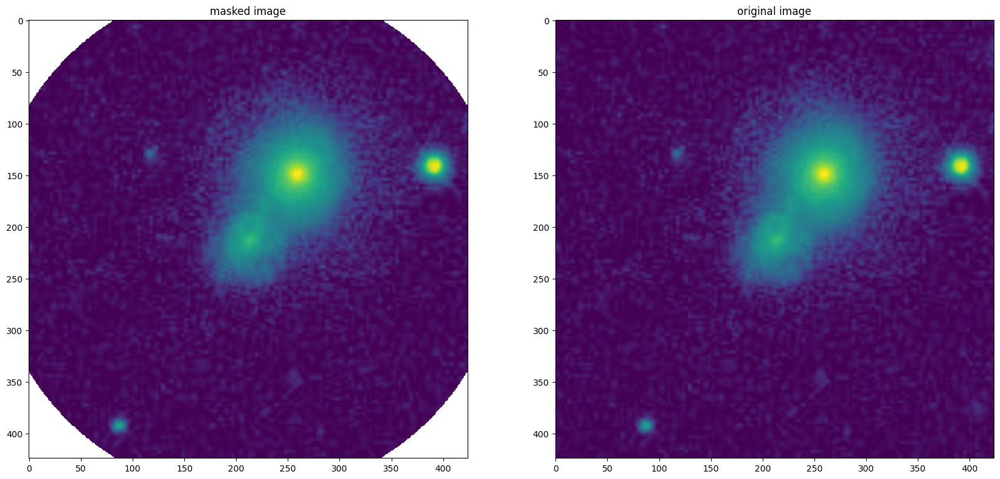

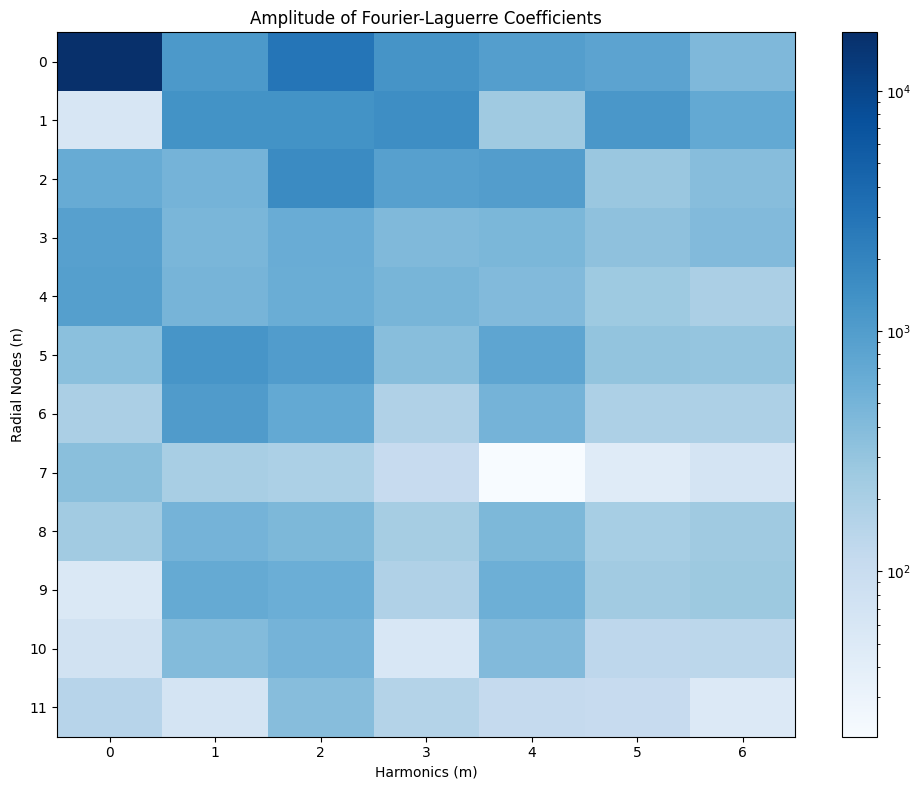

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


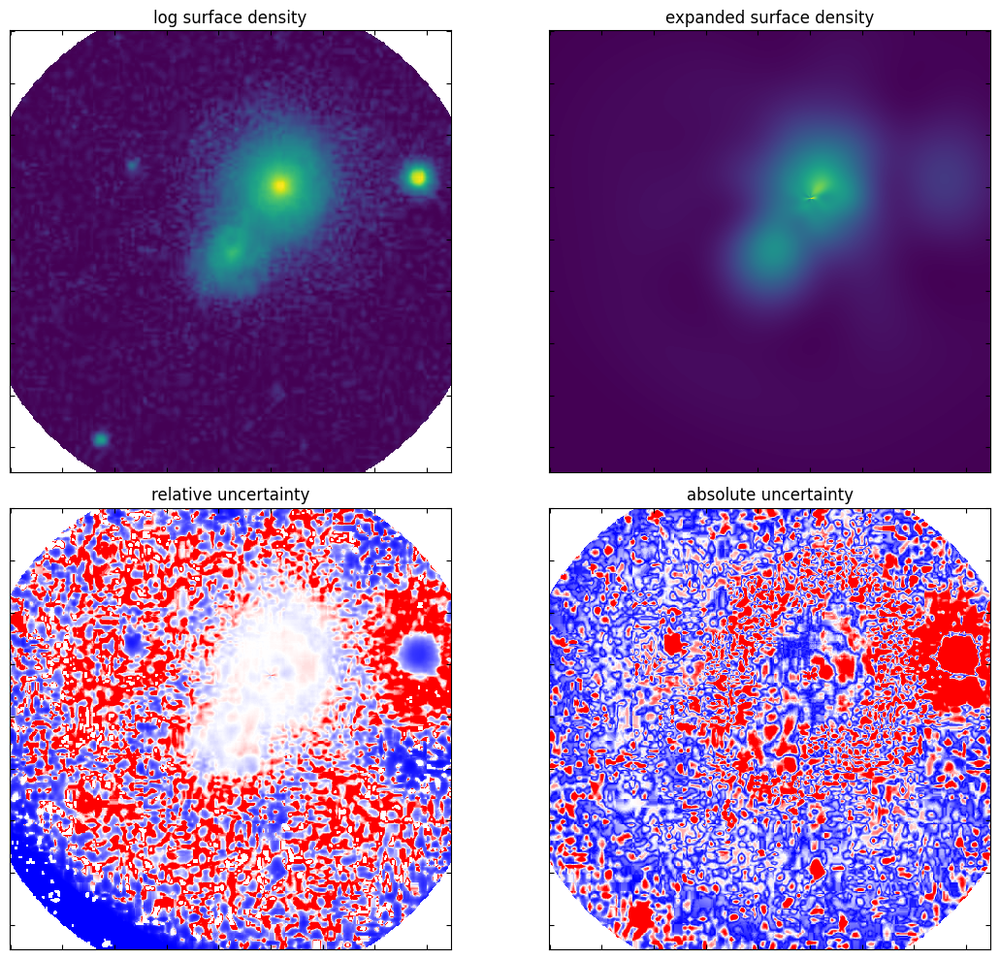

returning cosine coefficients, sine coefficients
length 2.8125
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

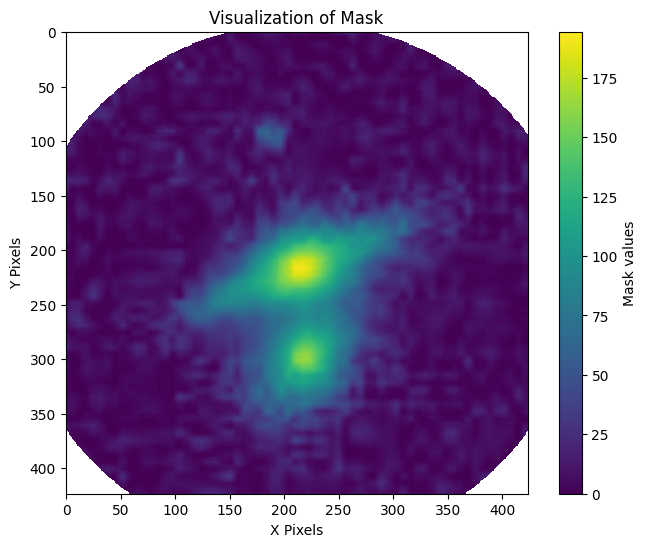

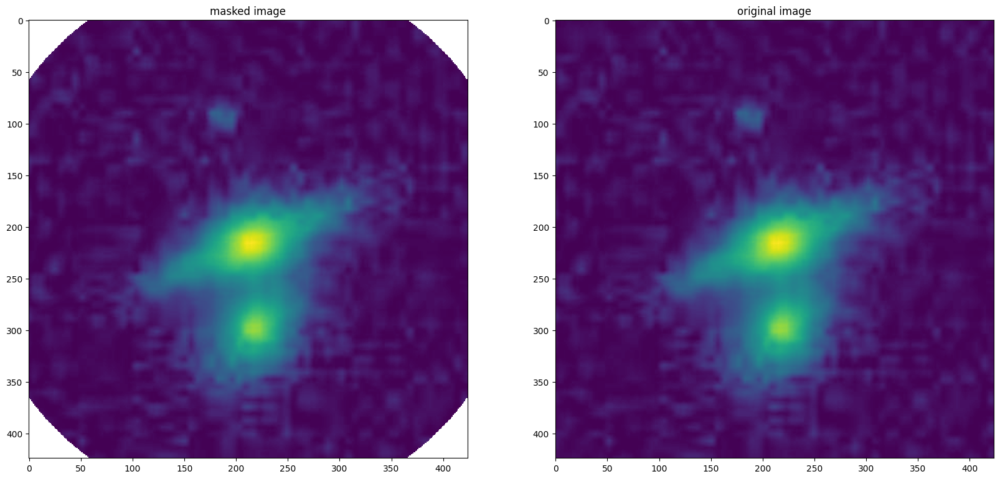

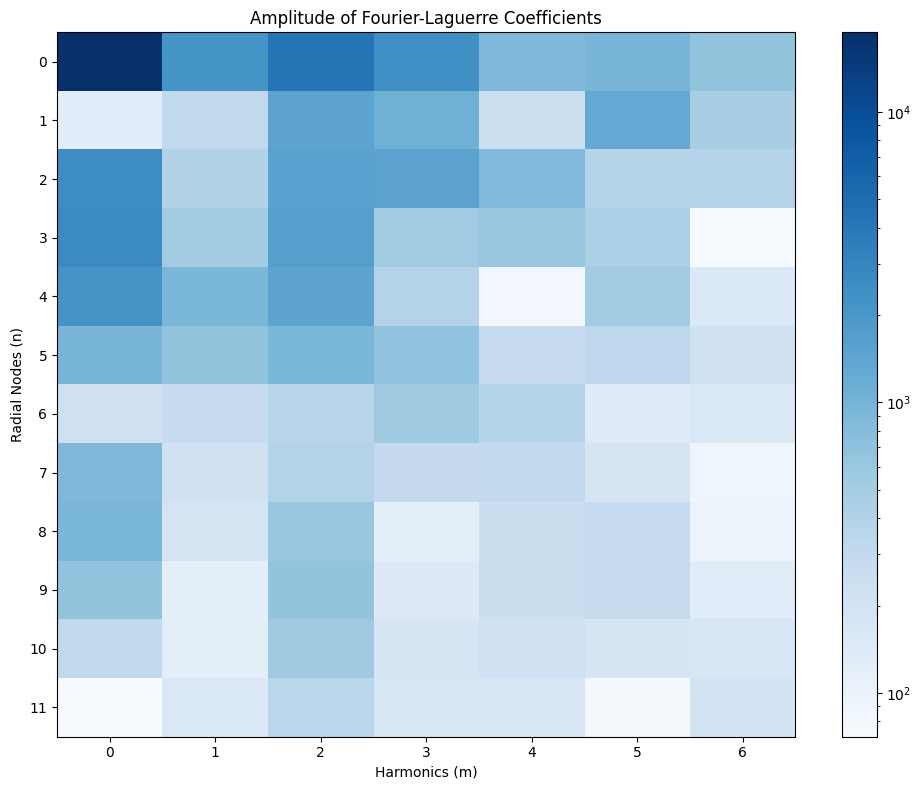

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


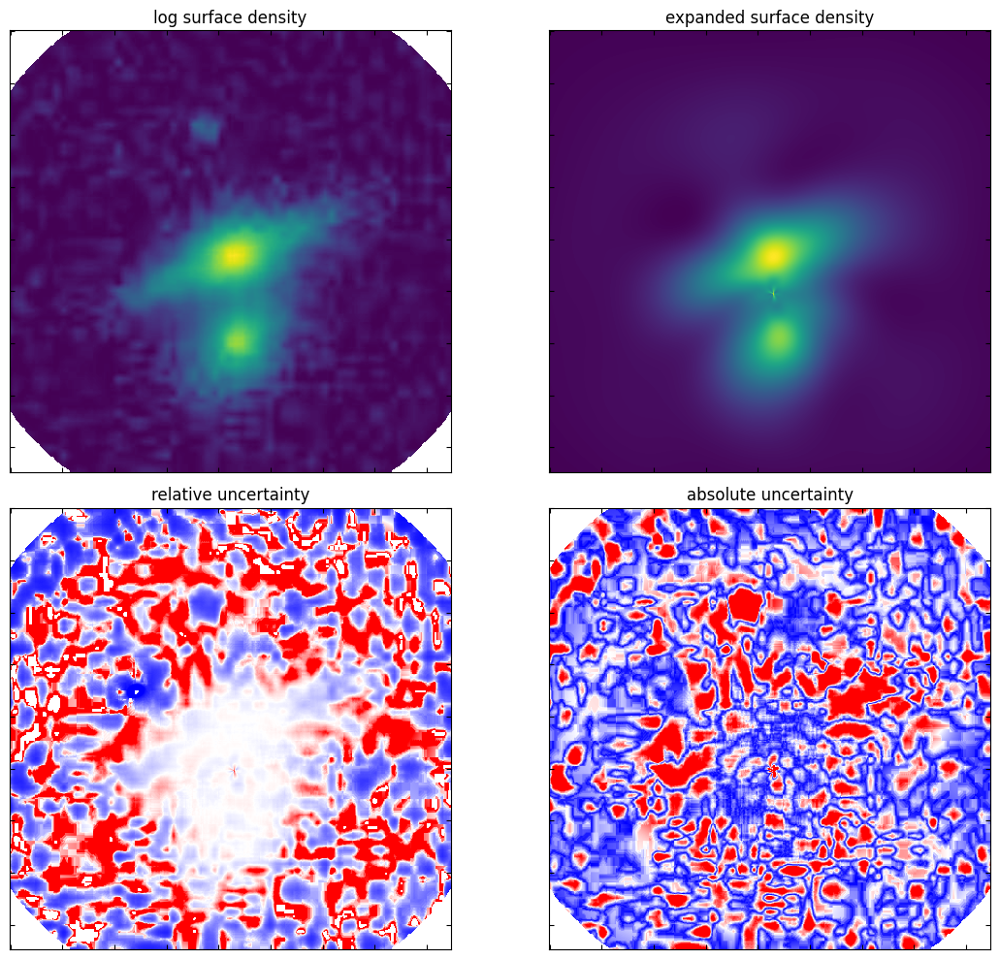

returning cosine coefficients, sine coefficients
length 2.520833333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloci

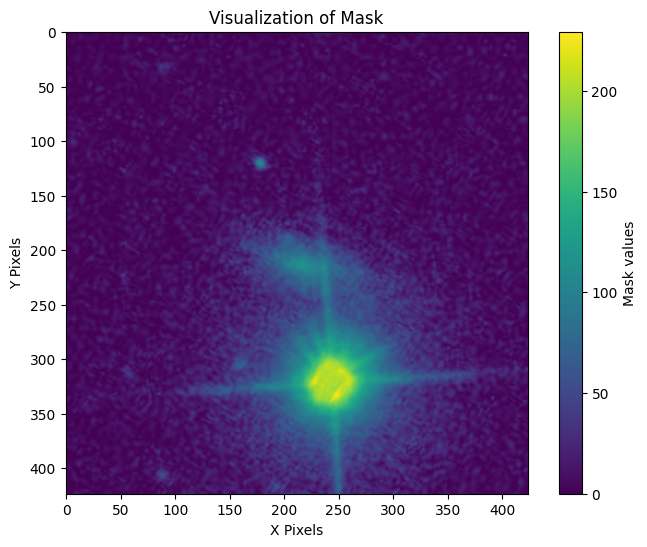

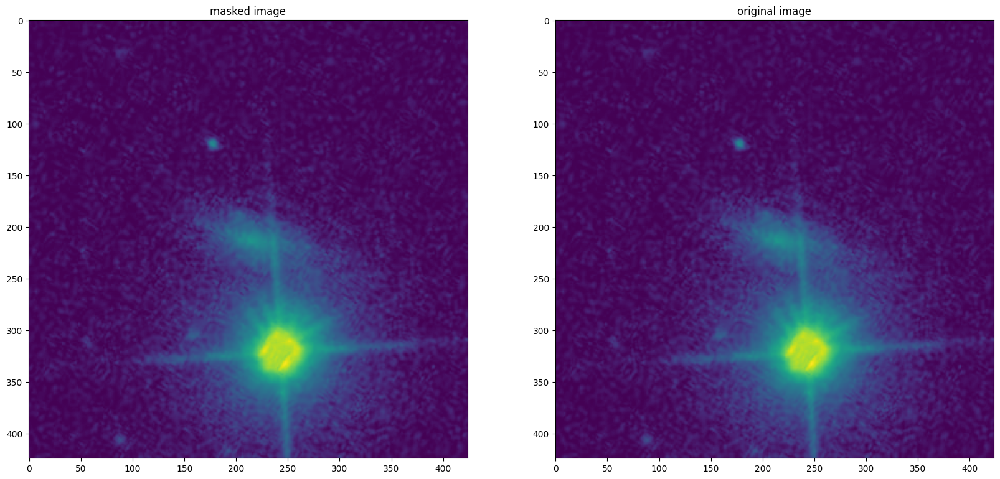

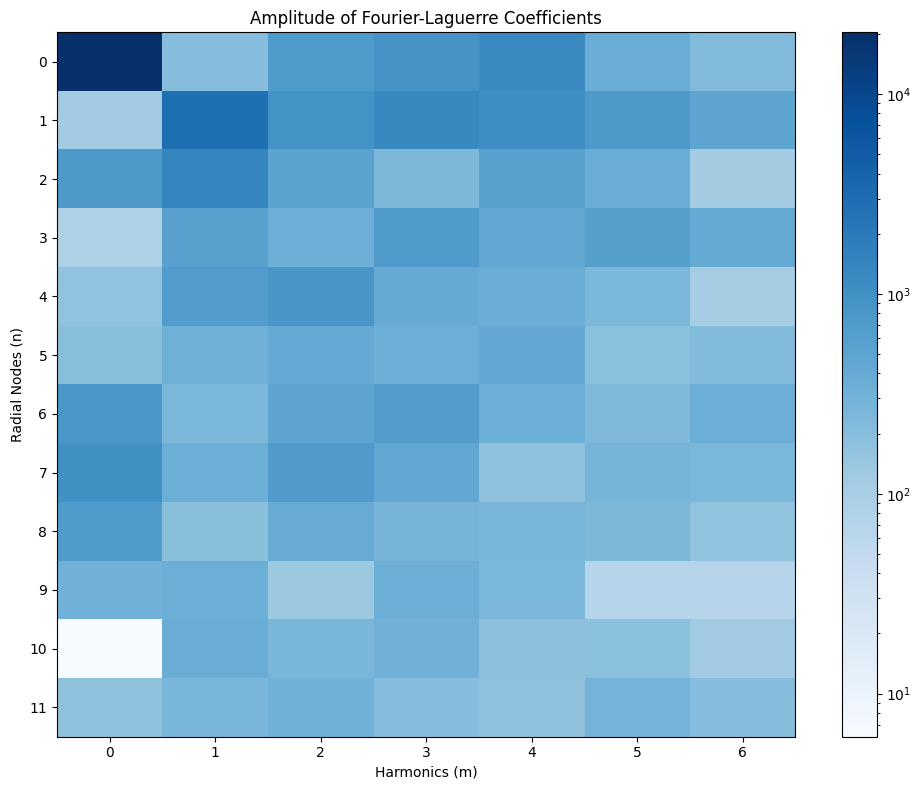

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


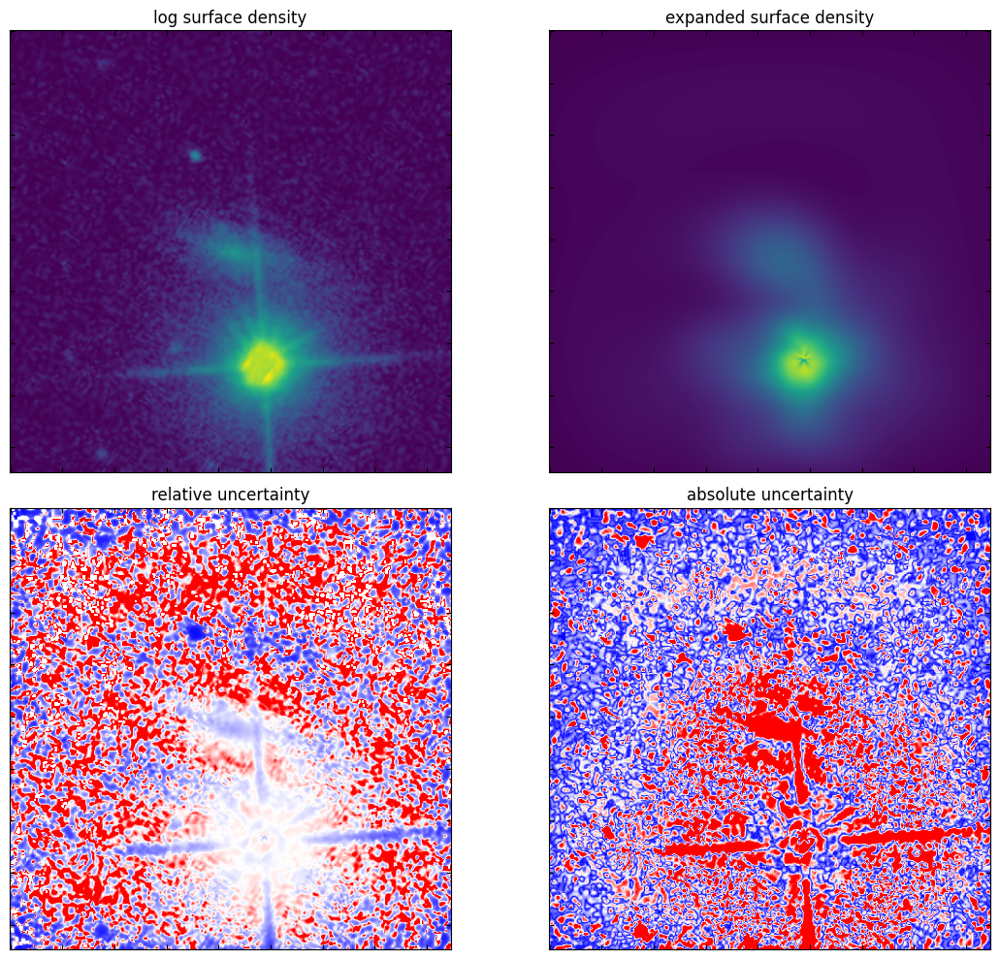

returning cosine coefficients, sine coefficients
length 2.5625
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=57, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time

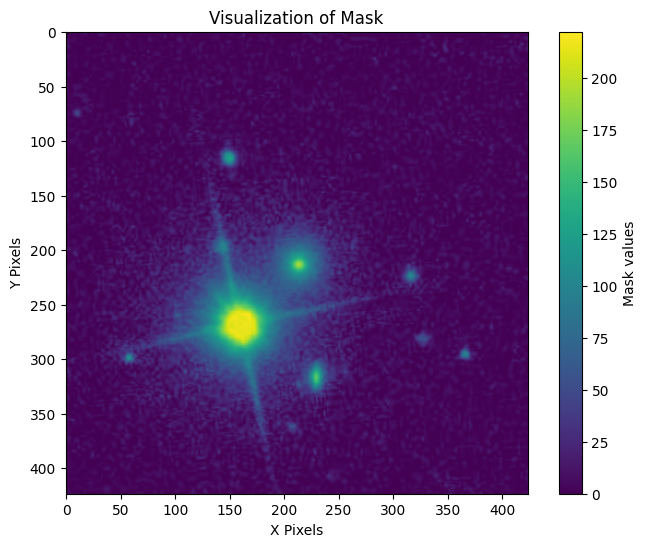

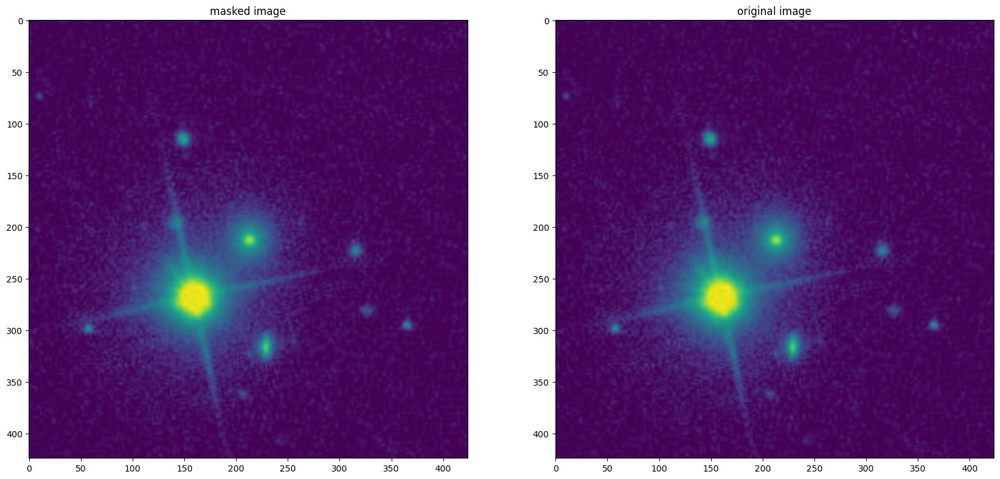

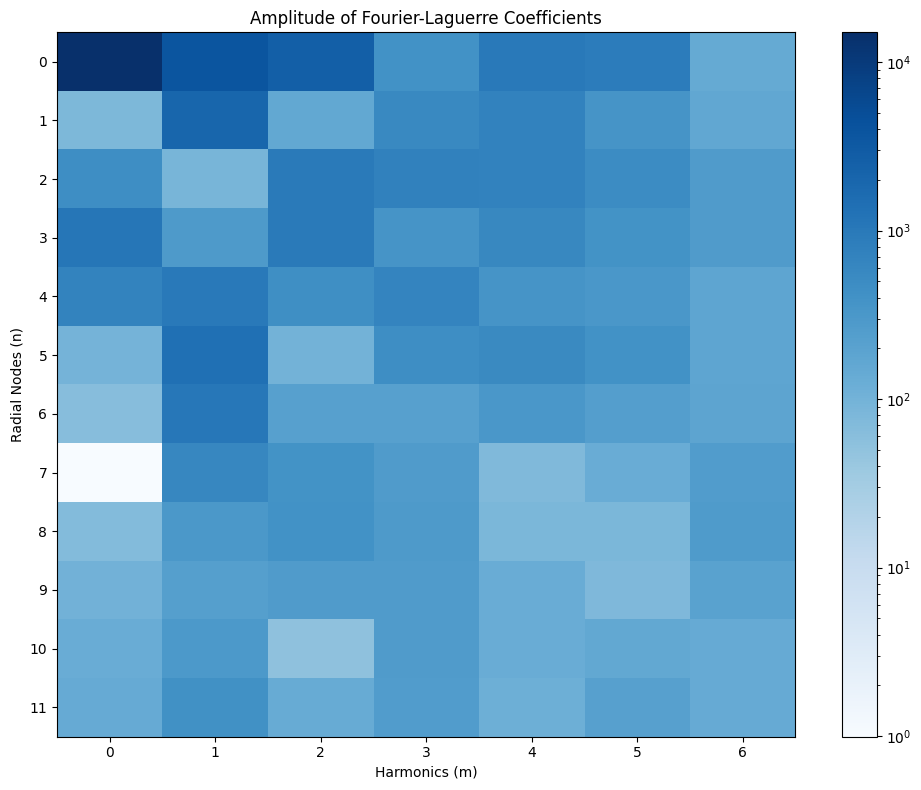

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


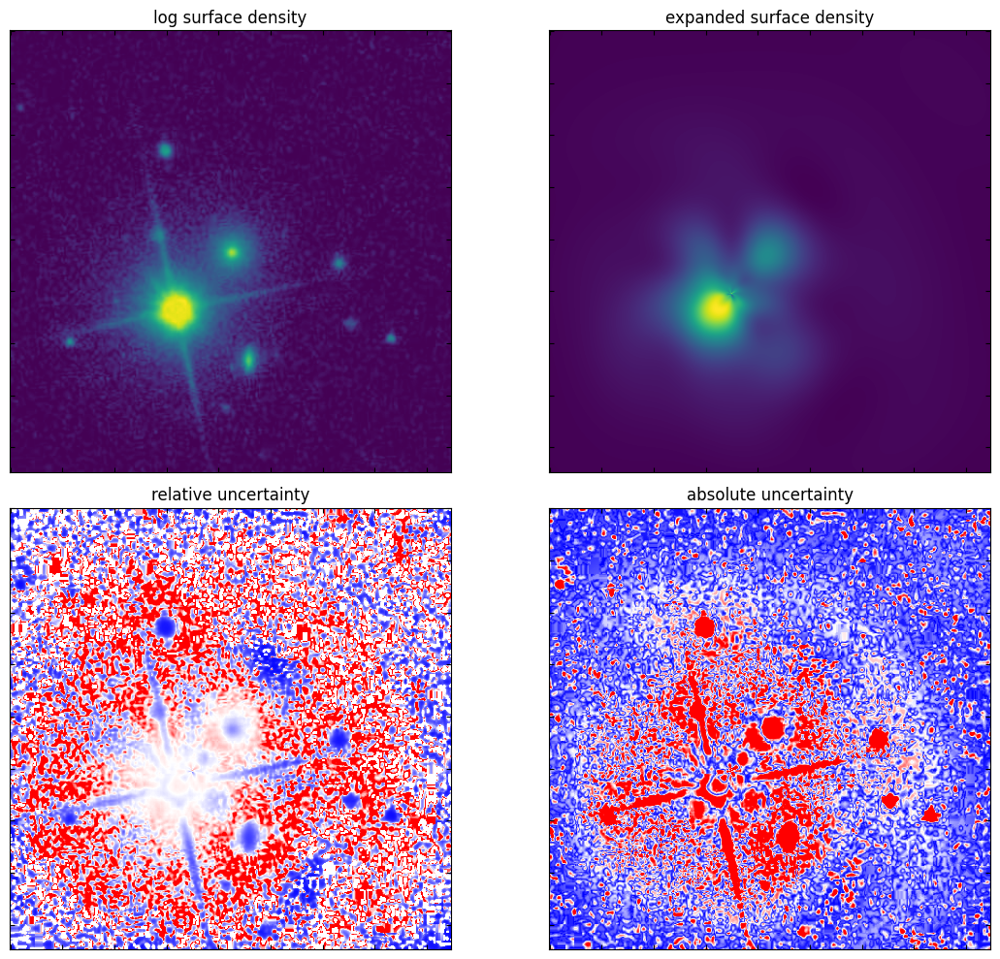

returning cosine coefficients, sine coefficients
length 2.520833333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=53, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloci

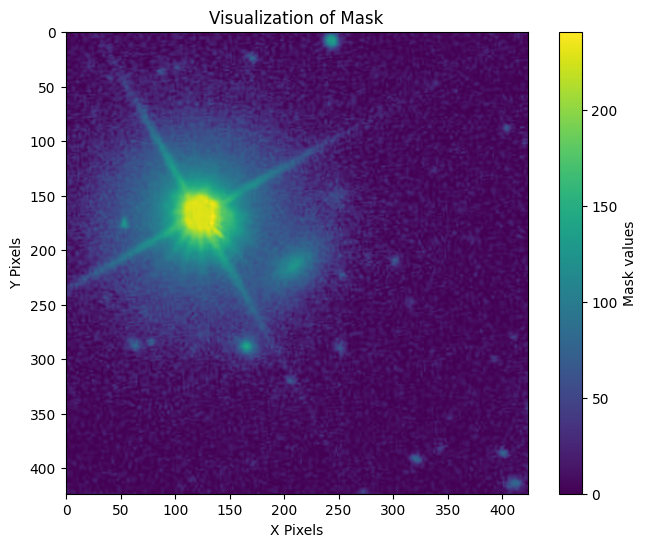

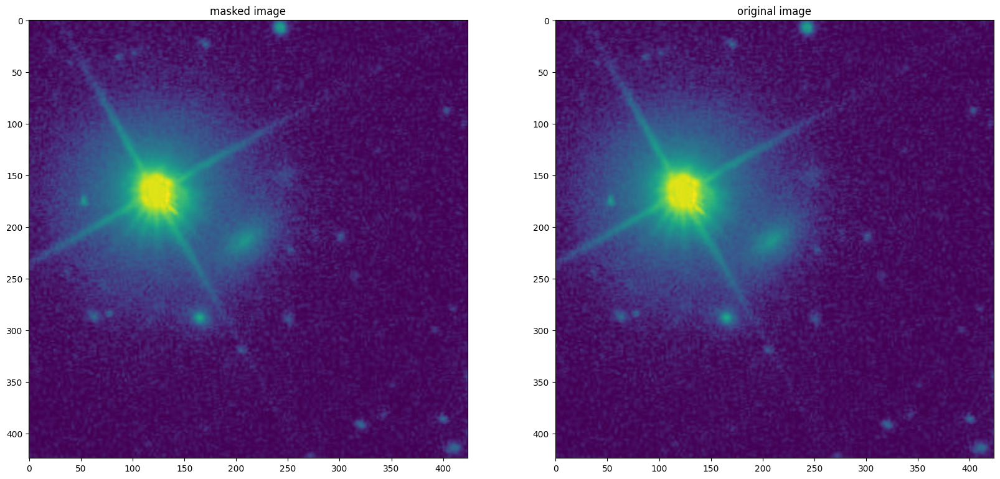

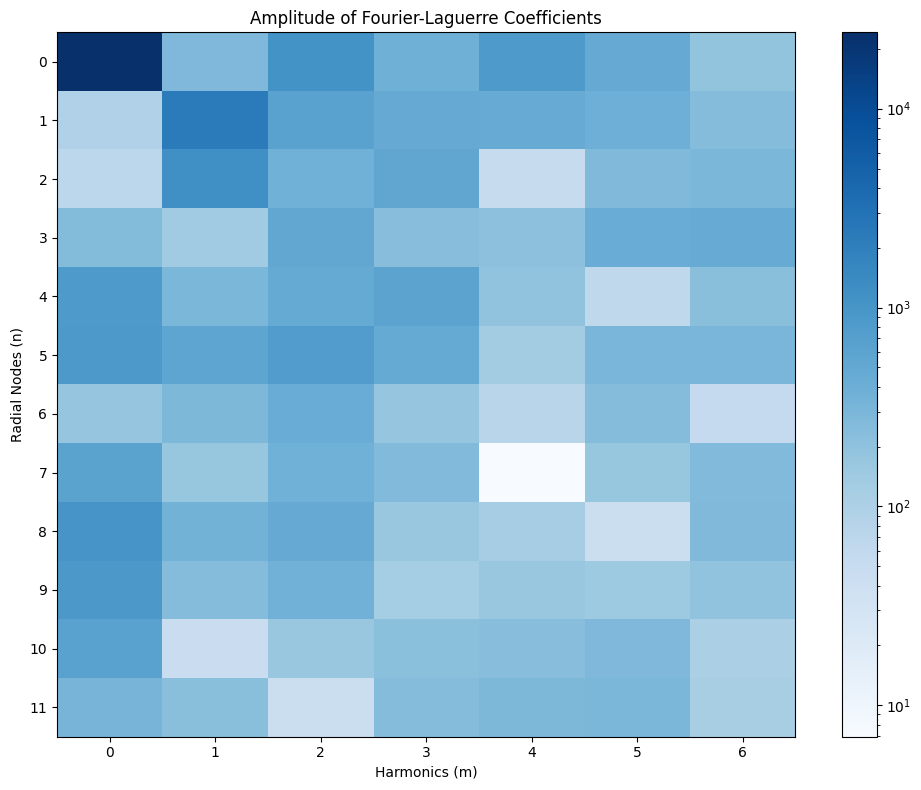

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


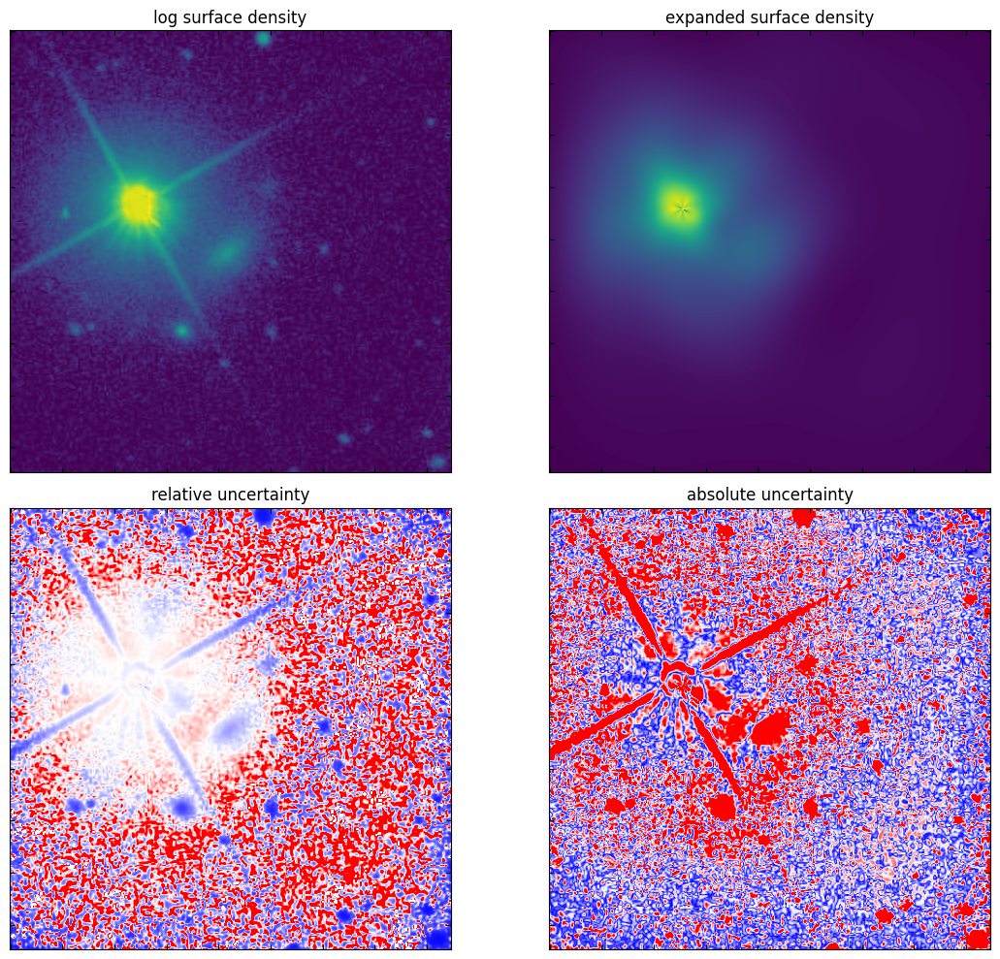

returning cosine coefficients, sine coefficients
length 2.020833333333333
MidiFile(type=1, ticks_per_beat=480, tracks=[
  MidiTrack([
    Message('program_change', channel=6, program=124, time=0),
    Message('program_change', channel=5, program=113, time=0),
    Message('program_change', channel=4, program=76, time=0),
    Message('program_change', channel=3, program=16, time=0),
    Message('program_change', channel=2, program=79, time=0),
    Message('program_change', channel=1, program=16, time=0),
    Message('program_change', channel=0, program=1, time=0),
    MetaMessage('set_tempo', tempo=500000, time=0),
    Message('note_on', channel=0, note=51, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=48, velocity=60, time=0),
    Message('note_off', channel=0, note=51, velocity=60, time=20),
    Message('note_on', channel=0, note=55, velocity=60, time=0),
    Message('note_off', channel=0, note=51, veloci

In [299]:
full_collection = [elliptical, edge_on, spiral, barred, interacting, artefact]
coefs = {}
name_list = []
length = 3
for galtype in full_collection:
    if 'GZ2_images/844.jpg' in galtype:
        gt = 'elliptical'
    elif 'GZ2_images/99129.jpg' in galtype:
        gt = 'edge_on'
    elif 'GZ2_images/290248.jpg' in galtype:
        gt = 'spiral'
    elif 'GZ2_images/290722.jpg' in galtype:
        gt = 'barred'
    elif 'GZ2_images/290026.jpg' in galtype:
        gt = 'interacting'
    elif 'GZ2_images/261434.jpg' in galtype:
        gt = 'artefact'

    for image in galtype:
        print(gt)
        cos_cos712, sin_cos712 = BeefIt('../'+str(image), rscl_initial = 10, 
                                            mmax_initial = 2, nmax_initial = 10,
                                           new_mmax = 7, new_nmax = 12)
        image_name = image.split('/')[1]
        image_name = image_name.split('.')[0]
        notes = mod_map_to_sounds_instruments_ampcutoff(cos_cos712, sin_cos712)
    
        #making wav file, plugging in soundfont then converting to wav    
        make_midi_chords([notes], 20, str(image_name)+'_'+gt+'_mapping3.mid', octave = 2, roll=False) 
        #! fluidsynth "../GeneralUser-GS.sf2" -L 7 -F {str(image_name)}_{gt}'_mapping3.wav' {str(image_name)}_{gt}'_mapping3.mid'
        #converting to MP3 - based on this: https://gist.github.com/kroger/6211862
        ! fluidsynth -F "{image_name}_{gt}_mapping3" "../GeneralUser-GS.sf2" "{image_name}_{gt}_mapping3.mid" && \
            lame "{image_name}_{gt}_mapping3"
        os.remove(str(image_name)+'_'+str(gt)+'_mapping3.mid')
        #os.remove(str(image_name)+'_'+str(gt)+'_mapping3.wav')

In [283]:
#spiral 51, 53, 48, 51

In [297]:
image_name = 844
gt = 'elliptical'
! fluidsynth -F "{image_name}_{gt}_mapping3" "../GeneralUser-GS.sf2" "{image_name}_{gt}_mapping3.mid" && \
            lame "{image_name}_{gt}_mapping3"


FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file '844_elliptical_mapping3'..
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16538 Hz - 17071 Hz
Encoding 844_elliptical_mapping3 to 844_elliptical_mapping3.mp3
Encoding as 44.1 kHz j-stereo MPEG-1 Layer III (11x) 128 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:12--------------------------------------------------------------------------
   kbps      %     %
     0/484    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:12--------------------------------------------------------------------------
   kbps      %     %
   100/484    (21%)|    0:00/    0:00|    0:00/    0:00|   140.69x|    0:00 
------------

opening image
Reff =  39.15054271283767  Galaxy Radius:  234.903256277026
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -0.052563878516771675 4.147312496089642
center finding iteration 0
center finding iteration 50
Center of mass at x = 1.6320020835386158, y = 2.12626209617183
finding best rscl
New rscl value: 30
updating to new_mmax, new_nmax


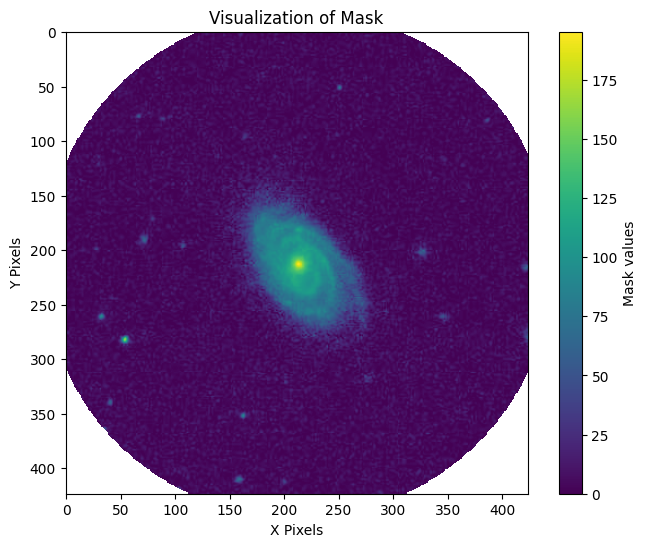

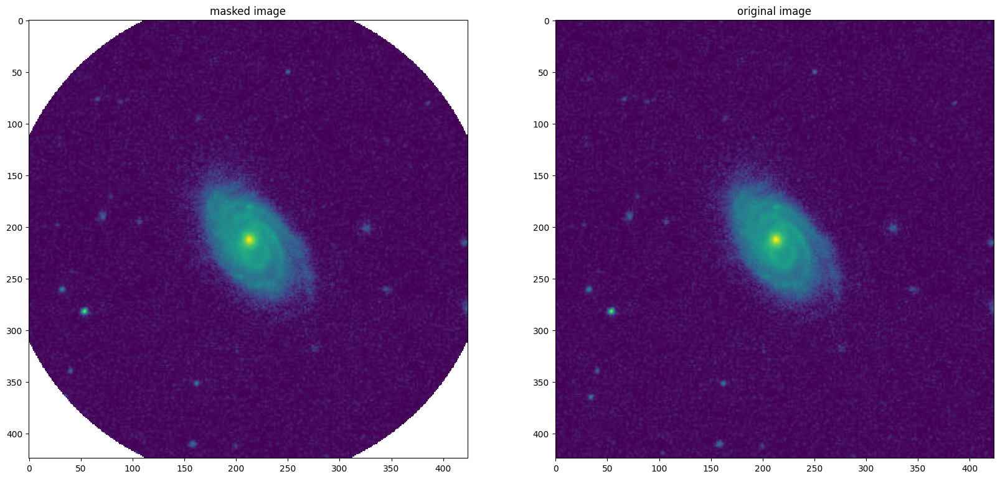

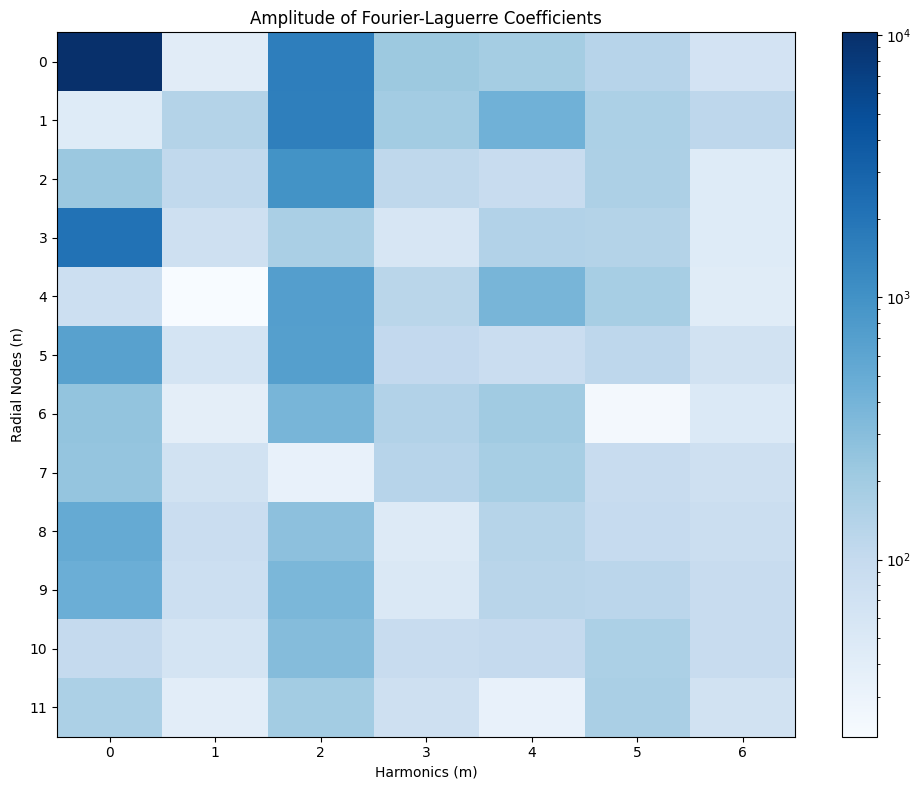

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


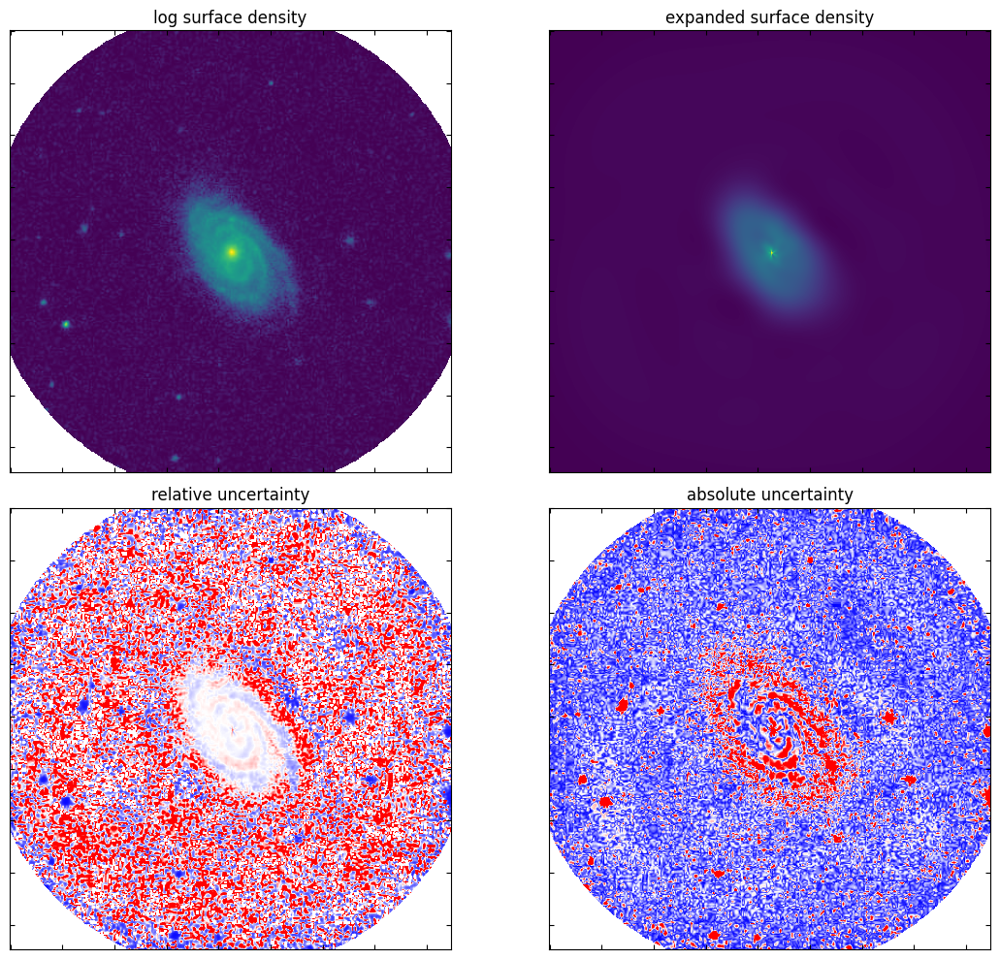

returning cosine coefficients, sine coefficients


In [268]:

cos_cos712, sin_cos712 = BeefIt('../'+str('GZ2_images/290248.jpg'), rscl_initial = 10, 
                                mmax_initial = 2, nmax_initial = 10,
                               new_mmax = 7, new_nmax = 12)
image_name = image.split('/')[1]
image_name = image_name.split('.')[0]


In [54]:
! fluidsynth "../GeneralUser-GS.sf2" -L 7 -F {str(image_name)}_{gt}'_mapping3.wav' {str(image_name)}_{gt}'_mapping3.mid'

FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file '261434_artefact_mapping3.wav'..
fluidsynth: warning: The file-renderer currently only supports a single stereo channel. You have provided 7 stereo channels. Audio may sound strange or incomplete.


# testing different sounds...

In [112]:
program_list = [1, 59, 14, 72, 69, 74, 113]
#need to take in chords in Strauss format, i.e. [[chord],[chord],[etc]]
# Create a new MIDI file and track
#[44, 71, 43, 72, 42, 69, 74]
mid = MidiFile()
track = MidiTrack()
mid.tracks.append(track)

# Set the tempo (optional, here 120 BPM)
tempo = mido.bpm2tempo(120)
track.append(mido.MetaMessage('set_tempo', tempo=tempo))

# Insert program change at the beginning of the track
program_change = mido.Message('program_change', program=program_list[0],channel=0) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[1],channel=1) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[2],channel=2) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[3],channel=3) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[4],channel=4) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[5],channel=5) 
track.insert(0, program_change) #bank zero, program change
program_change = mido.Message('program_change', program=program_list[6],channel=6) 
track.insert(0, program_change) #bank zero, program change


track.append(Message('note_on', note=53, velocity=127, channel=0, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=1, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=2, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=3, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=4, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=5, time=0))
track.append(Message('note_on', note=53, velocity=127, channel=6, time=0))
track.append(Message('note_off', note=53, velocity=127, channel=0, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=1, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=2, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=3, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=4, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=5, time=200))
track.append(Message('note_off', note=53, velocity=127, channel=6, time=200))
mid.save('test.mid')

In [257]:
program_list = [1, 16, 79, 16, 76, 113, 124] #70 is gucci, relatively low
#72 is also good, bit lower than 70, hard to hear lowest notes
#71 is great, super clear, higher than 70/72
#80 is a bit higher, synth sounding
#74 is also a bit hard to hear at lowest notes
#79 is great, easy to hear, bit higher than 70/72
#61 is v horn sounding, around 70/72 i think
#13 is so great, good lower
#77 is good, low
#maybe: 13, 77, 70, 71, 79, 61, 76

#71 kinda pitchy, 61 isnt it
mid = MidiFile()
track = MidiTrack()
mid.tracks.append(track)

# Set the tempo (optional, here 120 BPM)
tempo = mido.bpm2tempo(120)
track.append(mido.MetaMessage('set_tempo', tempo=tempo))

# Insert program change at the beginning of the track
num = 6
program_change = mido.Message('program_change', program=program_list[num],channel=0) 
track.insert(0, program_change) #bank zero, program change

notes = [24+2*12, 26+2*12, 28+2*12, 29+2*12, 31+2*12, 33+2*12, 35+2*12] #c, d, e, f, g, a in 2nd oct
track.append(Message('note_on', note=notes[0], velocity=127, channel=0, time=0))
track.append(Message('note_off', note=notes[0], velocity=127, channel=0, time=50))

track.append(Message('note_on', note=notes[1], velocity=127, channel=0, time=50))
track.append(Message('note_off', note=notes[1], velocity=127, channel=0, time=100))

track.append(Message('note_on', note=notes[2], velocity=127, channel=0, time=100))
track.append(Message('note_off', note=notes[2], velocity=127, channel=0, time=150))

track.append(Message('note_on', note=notes[3], velocity=127, channel=0, time=150))
track.append(Message('note_off', note=notes[3], velocity=127, channel=0, time=200))

track.append(Message('note_on', note=notes[4], velocity=127, channel=0, time=200))
track.append(Message('note_off', note=notes[4], velocity=127, channel=0, time=250))

track.append(Message('note_on', note=notes[5], velocity=127, channel=0, time=250))
track.append(Message('note_off', note=notes[5], velocity=127, channel=0, time=300))

track.append(Message('note_on', note=notes[6], velocity=127, channel=0, time=300))
track.append(Message('note_off', note=notes[6], velocity=127, channel=0, time=350))
mid.save('test.mid')


            

In [258]:
! fluidsynth -ni -F 'test.wav' "../GeneralUser-GS.sf2" 'test.mid'

FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'test.wav'..
